<a href="https://colab.research.google.com/github/michcampoli/single-cell-pdac-project/blob/main/unsupervised_ml_scvi_umap_infercnv.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import h5py    
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd

import scanpy as sc
#import scvi
import anndata as ad
import matplotlib
import matplotlib.gridspec as gridspec
from sklearn.manifold import TSNE
import umap



from scipy import stats as st
from collections import OrderedDict
from collections import defaultdict
from collections import Counter
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import ElasticNet


#from sknetwork.clustering import Louvain



from scipy.io import mmread
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.neighbors import kneighbors_graph

import phenograph

In [ ]:
df1=pd.read_csv('Matrix1.csv')

In [ ]:
df2=pd.read_csv('Matrix2.csv')

In [ ]:
df3=pd.read_csv('Matrix3.csv')

In [ ]:
df4=pd.read_csv('Matrix4.csv')

In [ ]:
df5=pd.read_csv('Matrix5.csv')

In [ ]:
df6=pd.read_csv('Matrix6.csv')

In [ ]:
df7=pd.read_csv('Matrix7.csv')

In [ ]:
df8=pd.read_csv('Matrix8.csv')

In [ ]:
df9=pd.read_csv('Matrix9.csv')

In [ ]:
df10=pd.read_csv('Matrix10.csv')

In [ ]:
df11=pd.read_csv('Matrix11.csv')

In [ ]:
df12=pd.read_csv('Matrix12.csv')

In [ ]:
df13=pd.read_csv('Matrix13.csv')

In [ ]:
df14=pd.read_csv('Matrix14.csv')

In [ ]:
df15=pd.read_csv('Matrix15.csv')

In [ ]:
df16=pd.read_csv('Matrix16.csv')

In [ ]:
df17=pd.read_csv('Matrix17.csv')

In [ ]:
df18=pd.read_csv('Matrix18.csv')

In [ ]:
df19=pd.read_csv('Matrix19.csv')

In [ ]:
for column1 in df1.columns:
    df1=df1[column1].str.split(' ',expand=True)

In [ ]:
for column in df2.columns:
    df2=df2[column].str.split(' ',expand=True)
    df3= df3[column].str.split(' ',expand=True)
    df4=df4[column].str.split(' ',expand=True)
    df5=df5[column].str.split(' ',expand=True)
    df6=df6[column].str.split(' ',expand=True)

In [ ]:
for column7 in df7.columns:
    df7=df7[column7].str.split(' ',expand=True)

In [ ]:
for column in df8.columns:
    df8=df8[column].str.split(' ',expand=True)
    df9= df9[column].str.split(' ',expand=True)
    df10=df10[column].str.split(' ',expand=True)
    df11=df11[column].str.split(' ',expand=True)
    df12=df12[column].str.split(' ',expand=True)

In [ ]:
for column in df13.columns:
    df13=df13[column].str.split(' ',expand=True)
    df14=df14[column].str.split(' ',expand=True)
    df15=df15[column].str.split(' ',expand=True)
    df16=df16[column].str.split(' ',expand=True)
    df17=df17[column].str.split(' ',expand=True)
    df18=df18[column].str.split(' ',expand=True)#not correct,just removed
    df19=df19[column].str.split(' ',expand=True)#not correct,just removed

In [ ]:
f=h5py.File('PAAD_CRA001160_expression.h5','r')

In [ ]:
genes=np.array(f['matrix']['features']['name'])[0:19000]

In [ ]:
df0=pd.read_csv('Matrix1.csv')
for column in df0.columns:
    cells=column.split(' ')

In [ ]:
len(genes)

19000

In [ ]:
len(cells)

57443

In [ ]:
df=pd.concat([df1,df2,df3,df4,df5,df6,df7,df8,df9,df10,df11,df12,df13,df14,df15,df16,df17])

In [ ]:
df=df.transpose()

In [ ]:
df.shape

(57443, 19000)

In [ ]:
df.head()

,0,1,2,3,4,5,6,7,8,9,...,990,991,992,993,994,995,996,997,998,999
0,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,...,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000
1,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.47493067,0.00000000,0.00000000,...,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000
2,0.13945869,0.00000000,0.00000000,0.13945869,0.00000000,0.00000000,0.00000000,0.13945869,0.00000000,0.00000000,...,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000
3,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,...,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000
4,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,...,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000


In [ ]:
df.columns=genes
df.index=cells

In [ ]:
df.head()

,b'AP006222.1',b'AL669831.1',b'AL669831.5',b'LINC00115',b'FAM41C',b'LINC02593',b'SAMD11',b'NOC2L',b'KLHL17',b'PLEKHN1',...,b'NECTIN3-AS1',b'AC020634.1',b'ROPN1B',b'AC010207.1',b'AC072039.2',b'WWTR1-AS1',b'WDR49',b'LINC00578',b'AC007823.1',b'CCDC39'
T2_AAAGATGAGCTTCGCG,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,...,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000
T2_AAATGCCCAAGCCGCT,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.47493067,0.00000000,0.00000000,...,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000
T2_AAGGCAGCAGGGAGAG,0.13945869,0.00000000,0.00000000,0.13945869,0.00000000,0.00000000,0.00000000,0.13945869,0.00000000,0.00000000,...,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000
T2_ACACTGAAGACCACGA,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,...,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000
T2_ACACTGATCCTTTCTC,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,...,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000,0.00000000


In [ ]:
df=df.astype(float)

In [ ]:
column_array=[]
for gene in df.columns:
    column_array.append(gene.decode("utf-8"))
df.columns=column_array
df

,AP006222.1,AL669831.1,AL669831.5,LINC00115,FAM41C,LINC02593,SAMD11,NOC2L,KLHL17,PLEKHN1,...,NECTIN3-AS1,AC020634.1,ROPN1B,AC010207.1,AC072039.2,WWTR1-AS1,WDR49,LINC00578,AC007823.1,CCDC39
T2_AAAGATGAGCTTCGCG,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
T2_AAATGCCCAAGCCGCT,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.474931,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
T2_AAGGCAGCAGGGAGAG,0.139459,0.0,0.0,0.139459,0.0,0.0,0.0,0.139459,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
T2_ACACTGAAGACCACGA,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
T2_ACACTGATCCTTTCTC,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
N11_GTCACGGCAGCGTTCG,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
N11_GTGGGTCGTGCCTGGT,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
N11_GTGTGCGTCAGGCGAA,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
N11_TACTTACCACAACGCC,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
df.to_pickle('BMEN4480_data.pkl')

In [ ]:
patients=[]
for index in df.index:
    patients.append(str(index)[0:3])
patients=np.unique(patients)

In [ ]:
patients=['N10_', 'N11_', 'N1_', 'N2_', 'N3_', 'N4_', 'N5_', 'N6_', 'N7_',
       'N8_', 'N9_', 'T10_', 'T11_', 'T12_', 'T13_', 'T14_', 'T15_', 'T16_',
       'T17_', 'T18_', 'T19_', 'T1_', 'T20_', 'T21_', 'T22_', 'T23_', 'T24_',
       'T2_', 'T3_', 'T4_', 'T5_', 'T6_', 'T7_', 'T8_', 'T9_']

In [ ]:
len(patients)

35

In [ ]:
df=pd.read_pickle('BMEN4480_data.pkl')

# Filter cells

In [ ]:
df.shape

(57443, 19000)

In [ ]:
DF= df[~df.index.duplicated(keep='first')]

In [ ]:
DF.shape

(57443, 19000)

In [ ]:
#DF.head()

In [ ]:
total_counts=np.log10(DF.sum(axis=1) + 0.1)

Text(0.5, 1.0, 'Cell library size')

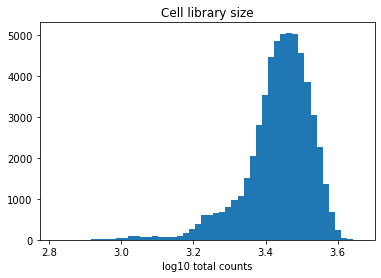

In [ ]:
plt.figure()
plt.hist(total_counts, bins=50)
plt.xlabel('log10 total counts')
plt.title('Cell library size')

In [ ]:
total_counts=total_counts[total_counts>3.2]

Text(0.5, 1.0, 'Cell library size - filtered')

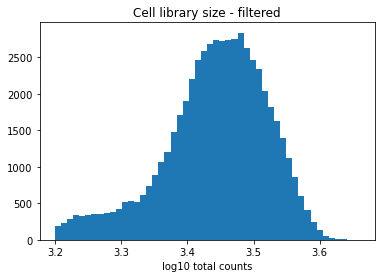

In [ ]:
plt.figure()
plt.hist(total_counts, bins=50)
plt.xlabel('log10 total counts')
plt.title('Cell library size - filtered')

In [ ]:
np.median(DF.sum(axis=0)) #median library size

2986.1794254250003

# Filter genes

In [ ]:
DF.shape

(57443, 19000)

In [ ]:
DF_tr= df.transpose()
DF_tr= DF_tr[~DF_tr.index.duplicated(keep='first')] #remove duplicated genes
DF = pd.DataFrame(DF_tr.transpose())

In [ ]:
DF.shape

(57443, 19000)

In [ ]:
binary = np.sign(DF)
ms_bin = np.log10(binary.sum(axis=0) + 0.1)

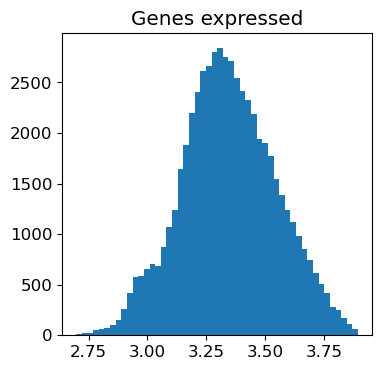

In [ ]:
plt.figure()
plt.hist(ms_bin, bins=50)
plt.title("Genes expressed")
plt.show()

In [ ]:
DF=pd.read_pickle('BMEN4480_data_filtered.pkl')

# Normalize data

In [ ]:
#log normalize data
ms = DF.sum(axis=1)
norm_DF = DF.div(ms, axis=0).mul(np.median(ms),axis=0)
DF_log = np.log(norm_DF + 0.1)
DF_log = DF_log.astype(np.float32)
DF_log.head()

,b'AP006222.1',b'AL669831.1',b'AL669831.5',b'LINC00115',b'FAM41C',b'LINC02593',b'SAMD11',b'NOC2L',b'KLHL17',b'PLEKHN1',...,b'NECTIN3-AS1',b'AC020634.1',b'ROPN1B',b'AC010207.1',b'AC072039.2',b'WWTR1-AS1',b'WDR49',b'LINC00578',b'AC007823.1',b'CCDC39'
T2_AAAGATGAGCTTCGCG,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,...,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585
T2_AAATGCCCAAGCCGCT,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-0.523346,-2.302585,-2.302585,...,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585
T2_AAGGCAGCAGGGAGAG,-1.367500,-2.302585,-2.302585,-1.367500,-2.302585,-2.302585,-2.302585,-1.367500,-2.302585,-2.302585,...,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585
T2_ACACTGAAGACCACGA,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,...,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585
T2_ACACTGATCCTTTCTC,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,...,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585


In [ ]:
column_array=[]
for gene in DF_log.columns:
    column_array.append(gene.decode("utf-8"))
DF_log.columns=column_array

In [ ]:
DF_log.shape

(57443, 19000)

In [ ]:
DF_log.to_pickle('BMEN4480_data_filtered_log.pkl')

# Umap - visualization

In [ ]:
DF=DF_log

In [ ]:
len(np.unique(DF_log.index))

57443

In [ ]:
#make anndata  - anndata required for umap
t1 = sc.AnnData(DF[DF.index.str.contains("T1_")])
t1.obs_names_make_unique()

t2 = sc.AnnData(DF[DF.index.str.contains("T2_")])
t2.obs_names_make_unique()

t3 = sc.AnnData(DF[DF.index.str.contains("T3_")])
t3.obs_names_make_unique()

t4 = sc.AnnData(DF[DF.index.str.contains("T4_")])
t4.obs_names_make_unique()

t5 = sc.AnnData(DF[DF.index.str.contains("T5_")])
t5.obs_names_make_unique()

t6 = sc.AnnData(DF[DF.index.str.contains("T6_")])
t6.obs_names_make_unique()

t7 = sc.AnnData(DF[DF.index.str.contains("T7_")])
t7.obs_names_make_unique()

t8 = sc.AnnData(DF[DF.index.str.contains("T8_")])
t8.obs_names_make_unique()

t9 = sc.AnnData(DF[DF.index.str.contains("T9_")])
t9.obs_names_make_unique()

t10 = sc.AnnData(DF[DF.index.str.contains("T10_")])
t10.obs_names_make_unique()

t11 = sc.AnnData(DF[DF.index.str.contains("T11_")])
t11.obs_names_make_unique()

t12 = sc.AnnData(DF[DF.index.str.contains("T12_")])
t12.obs_names_make_unique()

t13 = sc.AnnData(DF[DF.index.str.contains("T13_")])
t13.obs_names_make_unique()

t14 = sc.AnnData(DF[DF.index.str.contains("T14_")])
t14.obs_names_make_unique()

t15 = sc.AnnData(DF[DF.index.str.contains("T15_")])
t15.obs_names_make_unique()

t16 = sc.AnnData(DF[DF.index.str.contains("T16_")])
t16.obs_names_make_unique()

t17 = sc.AnnData(DF[DF.index.str.contains("T17_")])
t17.obs_names_make_unique()

t18 = sc.AnnData(DF[DF.index.str.contains("T18_")])
t18.obs_names_make_unique()

t19 = sc.AnnData(DF[DF.index.str.contains("T19_")])
t19.obs_names_make_unique()

t20 = sc.AnnData(DF[DF.index.str.contains("T20_")])
t20.obs_names_make_unique()

t21 = sc.AnnData(DF[DF.index.str.contains("T21_")])
t21.obs_names_make_unique()

t22= sc.AnnData(DF[DF.index.str.contains("T22_")])
t22.obs_names_make_unique()

t23= sc.AnnData(DF[DF.index.str.contains("T23_")])
t23.obs_names_make_unique()

t24= sc.AnnData(DF[DF.index.str.contains("T24_")])
t24.obs_names_make_unique()

n1 = sc.AnnData(DF[DF.index.str.contains("N1_")])
n1.obs_names_make_unique()
n2 = sc.AnnData(DF[DF.index.str.contains("N2_")])
n2.obs_names_make_unique()
n3 = sc.AnnData(DF[DF.index.str.contains("N3_")])
n3.obs_names_make_unique()
n4 = sc.AnnData(DF[DF.index.str.contains("N4_")])
n4.obs_names_make_unique()
n5 = sc.AnnData(DF[DF.index.str.contains("N5_")])
n5.obs_names_make_unique()
n6 = sc.AnnData(DF[DF.index.str.contains("N6_")])
n6.obs_names_make_unique()
n7 = sc.AnnData(DF[DF.index.str.contains("N7_")])
n7.obs_names_make_unique()
n8 = sc.AnnData(DF[DF.index.str.contains("N8_")])
n8.obs_names_make_unique()
n9 = sc.AnnData(DF[DF.index.str.contains("N9_")])
n9.obs_names_make_unique()
n10 = sc.AnnData(DF[DF.index.str.contains("N10_")])
n10.obs_names_make_unique()
n11 = sc.AnnData(DF[DF.index.str.contains("N11_")])
n11.obs_names_make_unique()

In [ ]:
adata = t1.concatenate(t2,t3,t4,t5,t6,t7,t8,t9,t10,t11,t12,t13,t14,t15,t16,t17,t18,t19,t20,t21,t22,t23,t24,n1,n2,n3,n4,n5,n6,n7,n8,n9,n10,n11)

In [ ]:
adata

AnnData object with n_obs × n_vars = 57443 × 19000
    obs: 'batch'

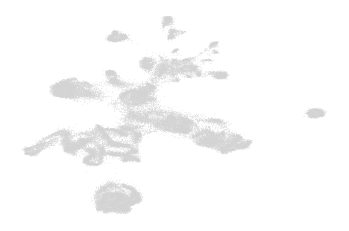

In [ ]:
sc.pp.neighbors(adata,use_rep="X")
sc.tl.umap(adata)
sc.pl.umap(
    adata,
    frameon=False,
    ncols=1,
)

In [ ]:
umap= pd.DataFrame(data=adata.obsm['X_umap'], index=adata.obs['batch'].index, columns=['x','y'])
umap

,x,y
T1_AAAGATGTCTTTACAC-0,-0.026485,9.153181
T1_ACCGTAATCATGGTCA-0,1.424456,4.593857
T1_CACATAGAGTACATGA-0,-1.008676,9.412431
T1_CGTCACTCAAAGCGGT-0,-0.434057,9.287330
T1_CTTAGGATCTTGCAAG-0,-0.936550,9.150476
...,...,...
N11_GTCACGGCAGCGTTCG-34,-1.065585,3.403984
N11_GTGGGTCGTGCCTGGT-34,-0.639487,3.065259
N11_GTGTGCGTCAGGCGAA-34,1.874034,3.385084
N11_TACTTACCACAACGCC-34,-0.794711,3.291776


In [ ]:
new_index=np.array(umap.index)
for i,index in enumerate(umap.index):
    if index[-2:-1]=='-':
        new_index[i]=index[:-2]
    elif index[-3:-2]=='-':
        new_index[i]=index[:-3]
umap.index=new_index

In [ ]:
umap

,x,y
T1_AAAGATGTCTTTACAC,-0.026485,9.153181
T1_ACCGTAATCATGGTCA,1.424456,4.593857
T1_CACATAGAGTACATGA,-1.008676,9.412431
T1_CGTCACTCAAAGCGGT,-0.434057,9.287330
T1_CTTAGGATCTTGCAAG,-0.936550,9.150476
...,...,...
N11_GTCACGGCAGCGTTCG,-1.065585,3.403984
N11_GTGGGTCGTGCCTGGT,-0.639487,3.065259
N11_GTGTGCGTCAGGCGAA,1.874034,3.385084
N11_TACTTACCACAACGCC,-0.794711,3.291776


In [ ]:
umap.to_csv('Umap_BMEN4480.csv')

In [ ]:
#for index in DF_log.index:
#    print(index)

# Umap colored by cell library size

Text(0.5, 1.0, 'Umap - Cell library size')

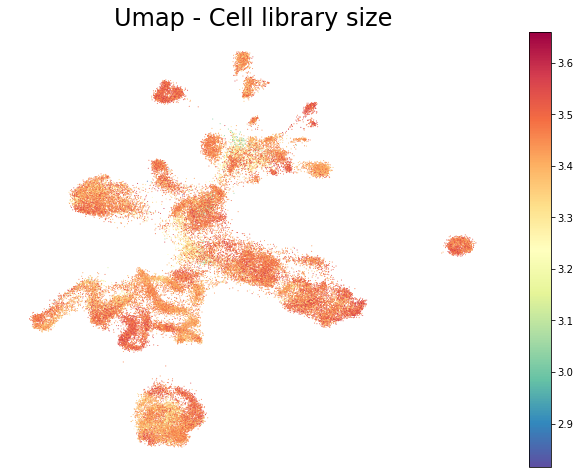

In [ ]:
fig = plt.figure(figsize=[11, 8])
cmap = plt.cm.Spectral_r
total_counts=np.log10(DF.sum(axis=1) + 0.1)
c=total_counts
plt.scatter(umap['x'],umap['y'], edgecolors='none',cmap=cmap, c=c,s=1)
plt.colorbar()
plt.axis('off')
plt.title("Umap - Cell library size", fontsize = 24)

# Umap colored by control vs. treatment

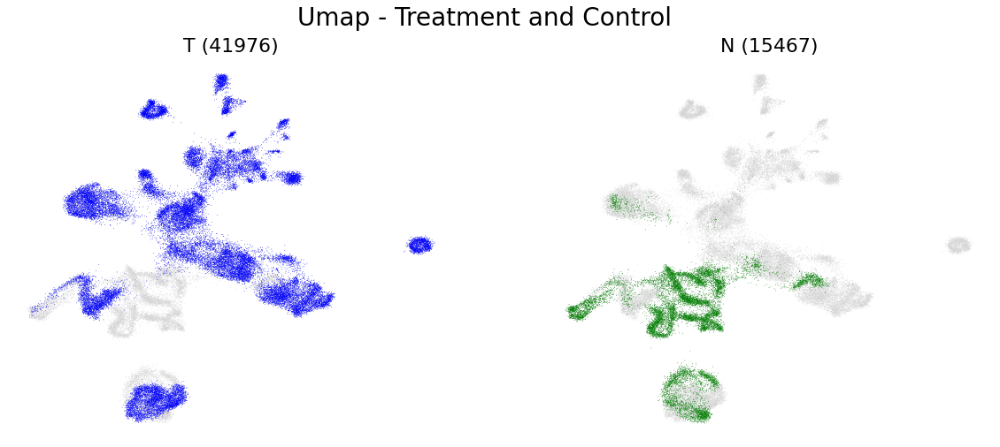

In [ ]:
timepoints = ['T', 'N']

colors=['b','g']
fig = plt.figure(figsize=[20 ,8])
cmap = plt.cm.Spectral_r
i=0
for count, timepoint in enumerate(timepoints):
    ax = fig.add_subplot(1, 2, i+1)
    ax.scatter(umap['x'],umap['y'], edgecolors='none', cmap=cmap, c='lightgrey',s=0.5)
    colored_cells=[]
    for index in umap.index:
        if str(index)[0]==timepoint:
            colored_cells.append(True)
        else:
            colored_cells.append(False)
    colored_cells_no = 0
    for value in colored_cells:
        if value == True:
            colored_cells_no += 1
    ax.scatter(umap.loc[colored_cells,'x'],umap.loc[colored_cells,'y'], edgecolors='none', cmap=cmap, c=colors[count],s=0.5)
    
    ax.set_title(timepoints[i]+' ('+str(colored_cells_no)+')', fontsize = 22)
    ax.set_axis_off()
    plt.suptitle("Umap - Treatment and Control", fontsize = 28)
    i += 1 

# Umap colored by patients

In [ ]:
import random
##function to generate random colors for coloring clusters
def random_colors(n): #n is the number of colors you need to generate
    color_set = np.zeros((n,3))
    for i in range(n):
        r = random.uniform(0, 1)
        b = random.uniform(0, 1)
        g = random.uniform(0, 1)
        color_set[i] = [r,b,g]
    return color_set

matplotlib.rcParams['figure.figsize'] = [4, 4]
matplotlib.rcParams['figure.dpi'] = 100
plt.rcParams.update({'font.size': 12})

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB o

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB o

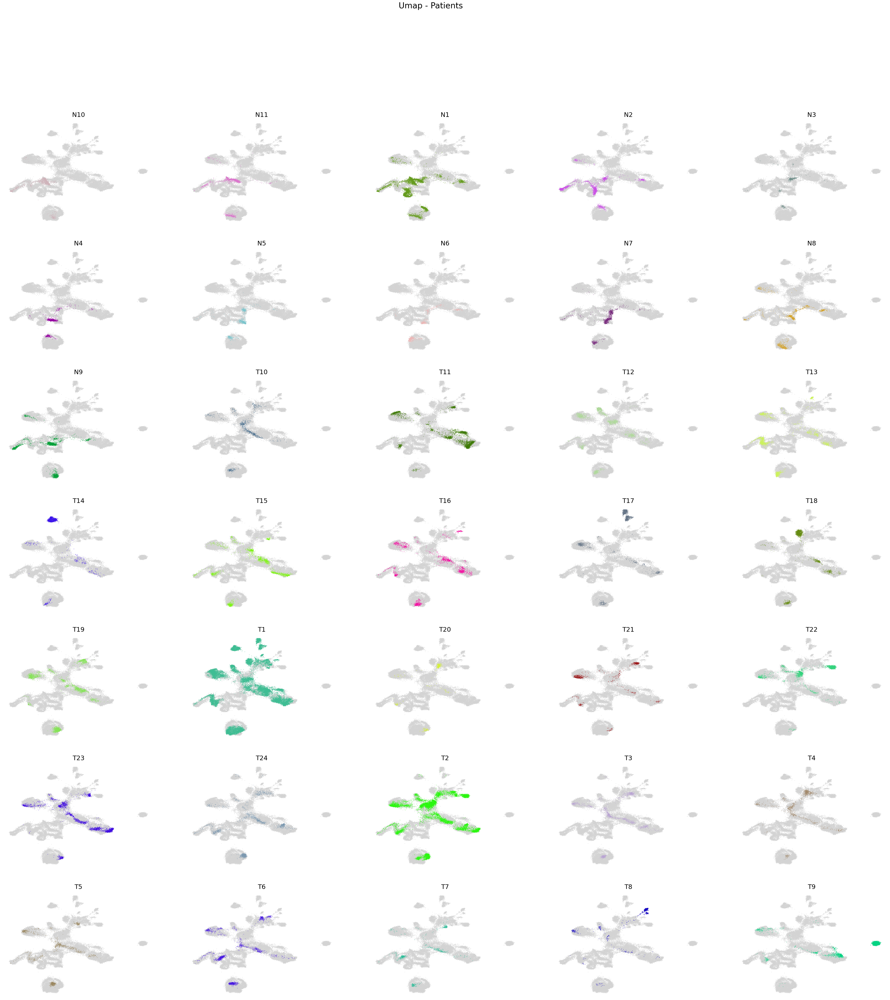

In [ ]:
patients=['N10', 'N11', 'N1', 'N2', 'N3', 'N4', 'N5', 'N6', 'N7',
       'N8', 'N9', 'T10', 'T11', 'T12', 'T13', 'T14', 'T15', 'T16',
       'T17', 'T18', 'T19', 'T1', 'T20', 'T21', 'T22', 'T23', 'T24',
       'T2', 'T3', 'T4', 'T5', 'T6', 'T7', 'T8', 'T9']
colors=random_colors(len(patients))

n_cols = 5; n_rows=7
fig = plt.figure(figsize=[11 * n_cols, 8*n_rows])

cmap = plt.cm.Spectral_r
i=0
for count, patient in enumerate(patients):
    ax = fig.add_subplot(n_rows, n_cols, i+1)
    ax.scatter(umap['x'],umap['y'], edgecolors='none', cmap=cmap, c='lightgrey',s=2)
    colored_cells=umap.index.str.contains(patient)
    ax.scatter(umap.loc[colored_cells,'x'],umap.loc[colored_cells,'y'], edgecolors='none', cmap=cmap, c=colors[count],s=2)
    ax.set_title(patient, fontsize = 22)
    ax.set_axis_off()
    plt.suptitle("Umap - Patients", fontsize = 28)
    i += 1

# Markers for PDAC

In [ ]:
umap=pd.read_csv('Umap_BMEN4480.csv',index_col=0)
umap.head()

,x,y
T1_AAAGATGTCTTTACAC,-0.026485,9.153181
T1_ACCGTAATCATGGTCA,1.424456,4.593857
T1_CACATAGAGTACATGA,-1.008676,9.412431
T1_CGTCACTCAAAGCGGT,-0.434057,9.287330
T1_CTTAGGATCTTGCAAG,-0.936550,9.150476


In [ ]:
markers=['NUP170', 'NUP160', 'HNRNPU', 'APOA1', 'CA125', 'CA19-9', 'CEA', 'APOA2', 'TTR']
#Shen, Quan et al. “Possible Molecular Markers for the Diagnosis of Pancreatic Ductal Adenocarcinoma.” 
#Medical science monitor : international medical journal of experimental and clinical research vol. 24 2368-2376. 19 Apr. 2018, doi:10.12659/msm.906313

In [ ]:
DF_log=pd.read_pickle('BMEN4480_data_filtered_log.pkl')
DF_log

,AP006222.1,AL669831.1,AL669831.5,LINC00115,FAM41C,LINC02593,SAMD11,NOC2L,KLHL17,PLEKHN1,...,NECTIN3-AS1,AC020634.1,ROPN1B,AC010207.1,AC072039.2,WWTR1-AS1,WDR49,LINC00578,AC007823.1,CCDC39
T2_AAAGATGAGCTTCGCG,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,...,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585
T2_AAATGCCCAAGCCGCT,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-0.523346,-2.302585,-2.302585,...,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585
T2_AAGGCAGCAGGGAGAG,-1.367500,-2.302585,-2.302585,-1.367500,-2.302585,-2.302585,-2.302585,-1.367500,-2.302585,-2.302585,...,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585
T2_ACACTGAAGACCACGA,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,...,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585
T2_ACACTGATCCTTTCTC,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,...,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
N11_GTCACGGCAGCGTTCG,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,...,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585
N11_GTGGGTCGTGCCTGGT,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,...,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585
N11_GTGTGCGTCAGGCGAA,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,...,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585
N11_TACTTACCACAACGCC,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,...,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585


In [ ]:
new=[]
for index in umap.index:
    new.append(index)
DF_log=DF_log.reindex(new)
DF_log

,AP006222.1,AL669831.1,AL669831.5,LINC00115,FAM41C,LINC02593,SAMD11,NOC2L,KLHL17,PLEKHN1,...,NECTIN3-AS1,AC020634.1,ROPN1B,AC010207.1,AC072039.2,WWTR1-AS1,WDR49,LINC00578,AC007823.1,CCDC39
T1_AAAGATGTCTTTACAC,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,...,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585
T1_ACCGTAATCATGGTCA,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,0.649441,-2.302585,-2.302585,-2.302585,...,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585
T1_CACATAGAGTACATGA,-2.302585,-2.302585,-0.267167,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,...,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585
T1_CGTCACTCAAAGCGGT,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,...,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585
T1_CTTAGGATCTTGCAAG,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-0.186991,-2.302585,-2.302585,...,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
N11_GTCACGGCAGCGTTCG,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,...,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585
N11_GTGGGTCGTGCCTGGT,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,...,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585
N11_GTGTGCGTCAGGCGAA,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,...,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585
N11_TACTTACCACAACGCC,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,...,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585


In [ ]:
DF_log.to_pickle('BMEN4480_data_filtered_log_reindex.pkl')

In [ ]:
for gene in DF_log.columns:
    for marker in markers:
        if marker== gene:
            print(gene)

HNRNPU
NUP160
APOA1
TTR


In [ ]:
markers=['HNRNPU','NUP160','APOA1','TTR']

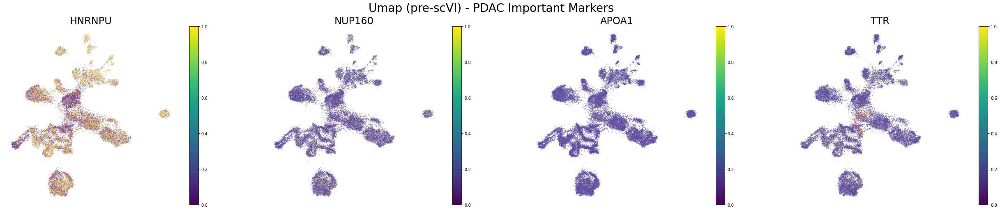

In [ ]:
n_rows=1; n_cols=4
fig = plt.figure(figsize=[11 * n_cols, 8*n_rows])
i = 0
cmap = plt.cm.Spectral_r
for value in markers: 
    ax = fig.add_subplot(n_rows, n_cols, i+1)
    plot = ax.scatter(umap['x'],umap['y'], edgecolors='none', cmap=cmap, c='lightgray', s=1)
    colored_cells=DF_log.loc[:,value].index
    counts = DF_log.loc[:,value]
    ax.scatter(umap.loc[colored_cells,'x'],umap.loc[colored_cells,'y'], edgecolors='none', cmap=cmap, c=counts,s=1)
    ax.set_title(value, fontsize = 24)
    fig.colorbar(plot,ax=ax)
    ax.set_axis_off()
    plt.suptitle("Umap (pre-scVI) - PDAC Important Markers", fontsize = 28)
    i += 1

In [ ]:
cell_dict = OrderedDict()
cell_dict['Myeloid'] = ['CD14','CD68','APOE','CD81','CD9','CD163','CD1C','FLT3','CD33'] 
cell_dict['NK'] = ['NCAM1','GNLY', 'NCR1', 'KIR2DL3', 'KIR3DL2']#  'KIR2DL4' 'KIR2DL1', 'KIR3DL1', 'KIR3DX1'] 
cell_dict['Macrophage'] = ['CD68','MRC1','MSR1','NRP1','CD82','CD14','CD163','CD86','CD81','C5AR1'] 
cell_dict['Monocyte'] = ['CD33', 'LYZ', 'FCN1', 'CSF3R', 'VCAN']# 'MPO',
cell_dict['B_cell'] = ['CD19','CD40LG','EBF1','TCF3','CD1C','CD19','MS4A1','CR2','CD27',
                       'CD22', 'CD79A', 'CD79B', 'POU2F2', 'CD19', 'MS4A1', 'EBF1', 'PAX5']#IGHD', 'IGHG1', 'IGHM'
cell_dict['HSC'] = ['CD34']
cell_dict['T_cell'] = ['CD3D','CD3E']
cell_dict['Prolif'] = ['MKI67', 'PCNA'] 
cell_dict['Erythroid']=['HBB', 'HBA1', 'HBA2', 'ALAS2', 'SOX6']#'HBD', 'HBM', 'GATA1']

celltype_counts = OrderedDict() #celltype_counts will have an array of normalized counts for each cell type
for key in cell_dict:
    gene_set = cell_dict[key]
    #print(key)
    #print(DF_log.loc[:,gene_set])
    counts_ = np.sum(DF_log.loc[:,gene_set],axis=1) #sum over each row
    counts_ = np.divide(counts_,len(gene_set))
    celltype_counts[key] = counts_

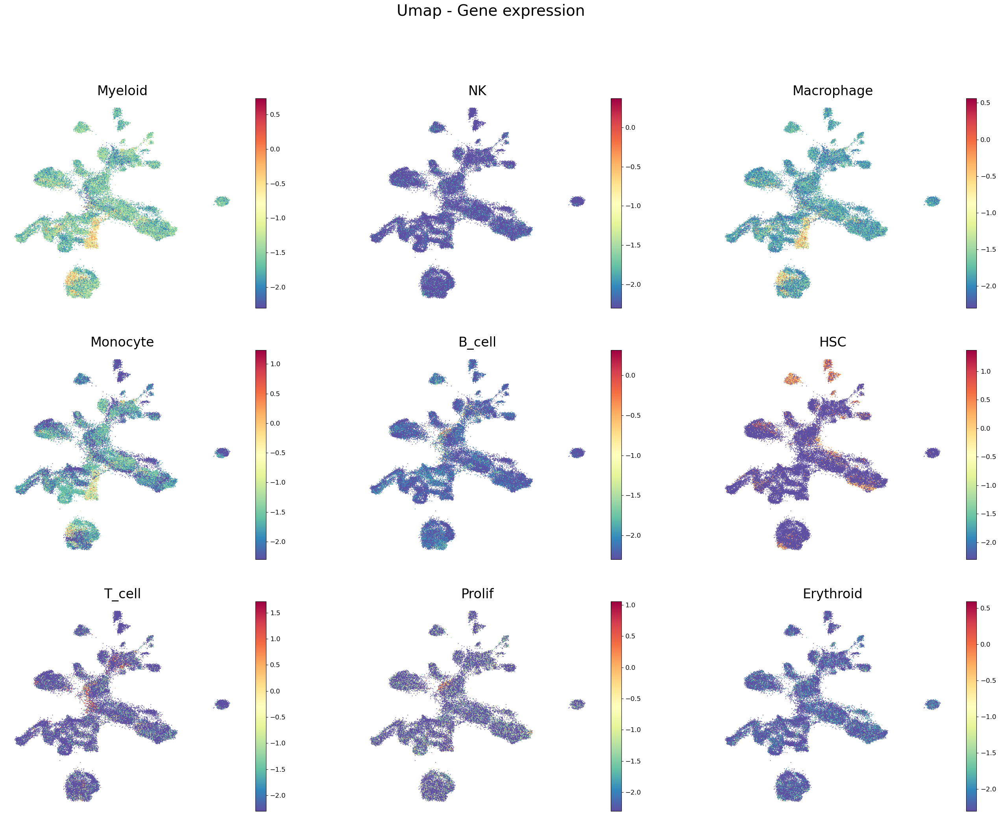

In [ ]:
n_cols = 3; n_rows=3
fig = plt.figure(figsize=[11 * n_cols, 8*n_rows])
i = 0
cmap = plt.cm.Spectral_r
for sample in celltype_counts:
    ax = fig.add_subplot(n_rows, n_cols, i+1)
    c = celltype_counts[sample]#zscore()
    #print(sample)
    #print(c)
    plot = ax.scatter(umap['x'],umap['y'], edgecolors='none',cmap=cmap, c=c, label=sample,s=2)#vmin=-1, vmax=1
    fig.colorbar(plot,ax=ax)
    ax.set_title(sample, fontsize = 24)
    ax.set_axis_off()
    plt.suptitle("Umap - Gene expression", fontsize = 28)
    i += 1

# Other markers - highly expressed in PDAC tumor cells

In [ ]:
#all samples had cycling cells: MKI67,  secretion (e.g., FABP1, SCG5), digestive enzymes (e.g., PRSS1, PGC), 
#cytoskeleton or cell adhesion genes (e.g., ANXA6, TUBB2B, and CEACAM6), MHC complex members
#(e.g., CD74, HLA-DQB1, and HLA-DRB1) and putative inflammasome inhibitory genes (e.g., TMEM176A, TMEM176B)
#https://www.nature.com/articles/s41467-021-26059-4.pdf

In [ ]:
cell_dict = OrderedDict()
cell_dict['Cycling']=['MKI67']
cell_dict['Secretion']=['FABP1','SCG5']
cell_dict['Digestive enzymes']=['PRSS1','PGC']
cell_dict['cytoskeleton/ cell adhesion']= ['ANXA6', 'TUBB2B',  'CEACAM6']
cell_dict['MHC complex members']=['CD74', 'HLA-DQB1', 'HLA-DRB1']
cell_dict['Putative inflammasome inhibitory genes']=['TMEM176A', 'TMEM176B']

celltype_counts = OrderedDict() #celltype_counts will have an array of normalized counts for each cell type
for key in cell_dict:
    gene_set = cell_dict[key]
    #print(key)
    #print(DF_log.loc[:,gene_set])
    counts_ = np.sum(DF_log.loc[:,gene_set],axis=1) #sum over each row
    counts_ = np.divide(counts_,len(gene_set))
    celltype_counts[key] = counts_

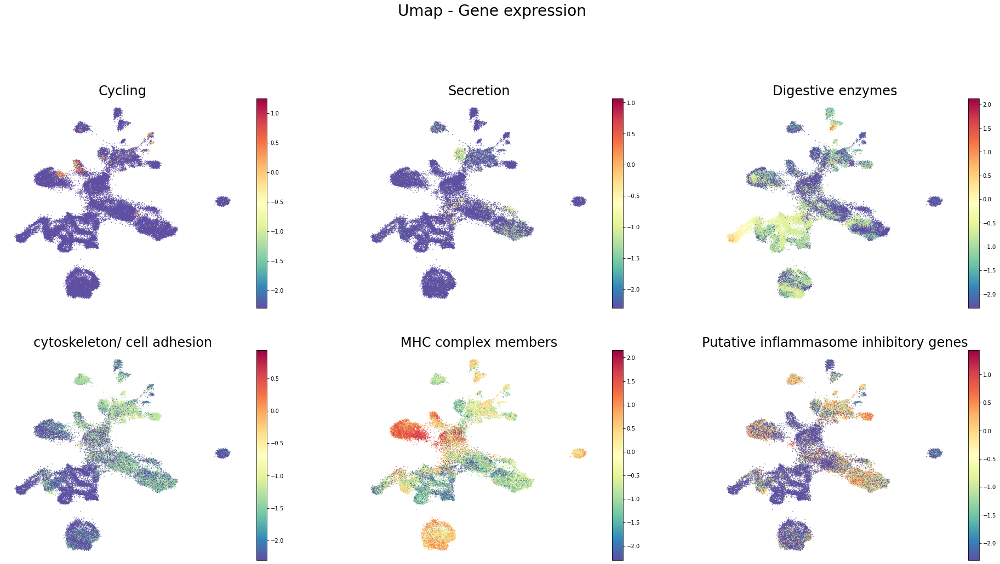

In [ ]:
n_cols = 3; n_rows=3
fig = plt.figure(figsize=[11 * n_cols, 8*n_rows])
i = 0
cmap = plt.cm.Spectral_r
for sample in celltype_counts:
    ax = fig.add_subplot(n_rows, n_cols, i+1)
    c = celltype_counts[sample]#zscore()
    #print(sample)
    #print(c)
    plot = ax.scatter(umap['x'],umap['y'], edgecolors='none',cmap=cmap, c=c, label=sample,s=2)#vmin=-1, vmax=1
    fig.colorbar(plot,ax=ax)
    ax.set_title(sample, fontsize = 24)
    ax.set_axis_off()
    plt.suptitle("Umap - Gene expression", fontsize = 28)
    i += 1

# Subtypes of T cells

In [ ]:
t1=pd.read_csv('T_Cell_markers_jessie.csv')

In [ ]:
t2=pd.read_csv('tcell_signatures.csv')

In [ ]:
all_tcell_sign=pd.concat([t1,t2])

In [ ]:
selected_signatures=['Activated T cells', 'Na�ve T cells', 'T effector cell',
'Exhausted T cells','Terminally Differentiated','CD8 T Cell Activation','TCell Exhaustion',
'Effector cell cytotoxicity','T cell co-inhibitory receptors']

In [ ]:
DF_log.head()

,AP006222.1,AL669831.1,AL669831.5,LINC00115,FAM41C,LINC02593,SAMD11,NOC2L,KLHL17,PLEKHN1,...,NECTIN3-AS1,AC020634.1,ROPN1B,AC010207.1,AC072039.2,WWTR1-AS1,WDR49,LINC00578,AC007823.1,CCDC39
T1_AAAGATGTCTTTACAC,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,...,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585
T1_ACCGTAATCATGGTCA,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,0.649441,-2.302585,-2.302585,-2.302585,...,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585
T1_CACATAGAGTACATGA,-2.302585,-2.302585,-0.267167,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,...,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585
T1_CGTCACTCAAAGCGGT,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,...,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585
T1_CTTAGGATCTTGCAAG,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-0.186991,-2.302585,-2.302585,...,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585


In [ ]:
signature_dict_t = OrderedDict()
weights_dict = OrderedDict()
for signature in selected_signatures:
    df_signatures = all_tcell_sign[signature]
    df_signatures = df_signatures.dropna()
    
    weights_array=[]
    new_list_t=[]
    for gene in df_signatures:
        #print(gene)
        if ((str(gene))[-1:]=='-') and ((str(gene))[:-1] in DF_log.columns):
            #print('yes','1',gene)
            new_list_t.append((str(gene))[:-1])
            weights_array.append(-1)
        elif ((str(gene))[-1:]=='+') and ((str(gene))[:-1] in DF_log.columns):
            #print('yes','2',gene)
            new_list_t.append((str(gene))[:-1])
            weights_array.append(1)
        elif str(gene) in DF_log.columns:
            #print('yes','3',gene)
            new_list_t.append(str(gene))
            weights_array.append(1)
    weights_dict[signature] = weights_array        
    signature_dict_t[signature] = new_list_t   

In [ ]:
sigtype_counts_t = OrderedDict() 
for key in signature_dict_t:
    #print(key)
    gene_set_t = signature_dict_t[key]
    counts_t = np.sum(np.multiply((DF_log-DF_log.loc['T1_AAAGATGTCTTTACAC','AP006222.1']).loc[:,gene_set_t],weights_dict[key]),axis=1) #sum over each row
    counts_t = np.divide(counts_t,len(gene_set_t))
    #print(counts_t.shape)
    sigtype_counts_t[key] = counts_t

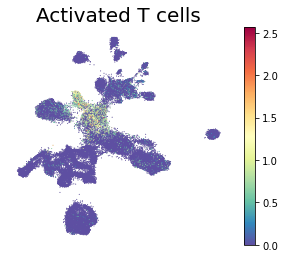

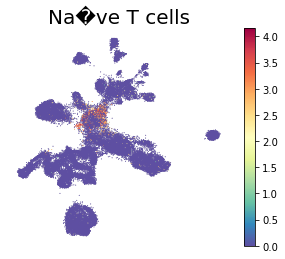

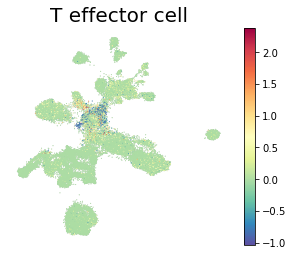

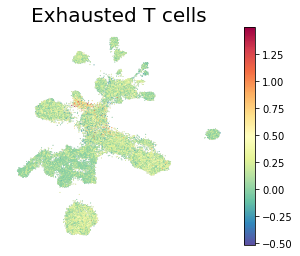

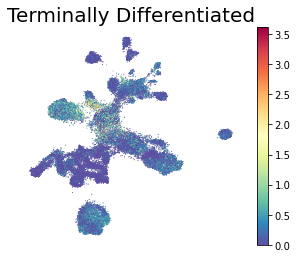

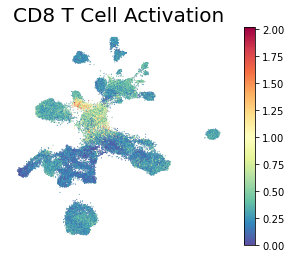

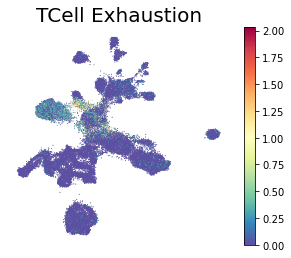

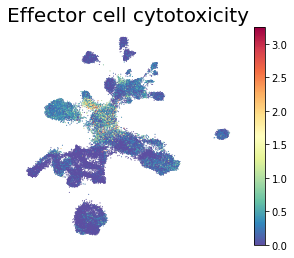

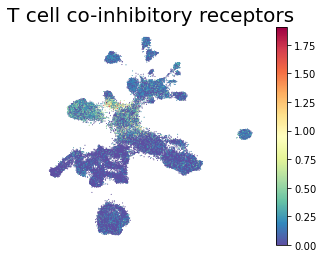

In [ ]:
#not zscored
for i,sample in enumerate(sigtype_counts_t):
    fig = plt.figure(figsize=[5 ,4])
    cmap = plt.cm.Spectral_r
    plt.scatter(umap['x'],umap['y'], edgecolors='none', cmap=cmap, c='lightgrey',s=1)
    c = sigtype_counts_t[sample]#zscore()
    cells = DF_log.index
    plot=plt.scatter(umap.loc[cells,'x'],umap.loc[cells,'y'], edgecolors='none',cmap=cmap, c=c, label=sample,s=1)
    fig.colorbar(plot)   
    plt.title(sample, fontsize = 20)
    plt.axis('off')

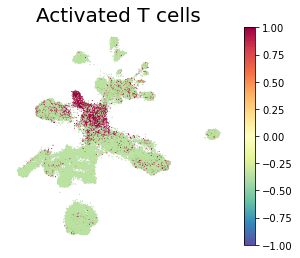

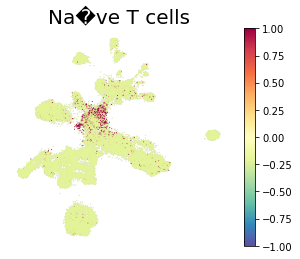

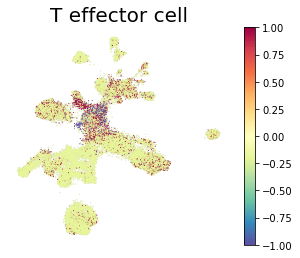

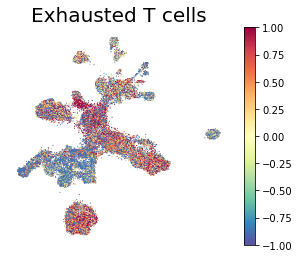

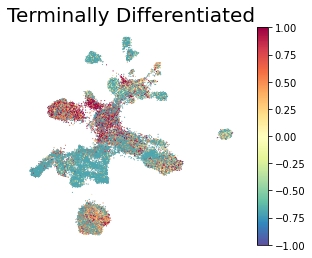

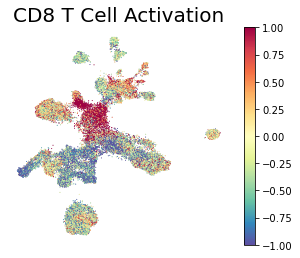

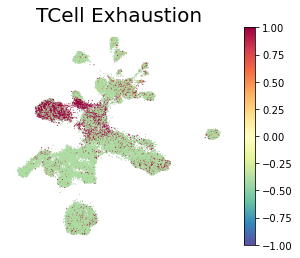

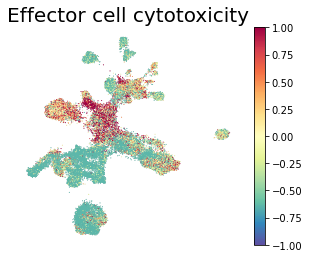

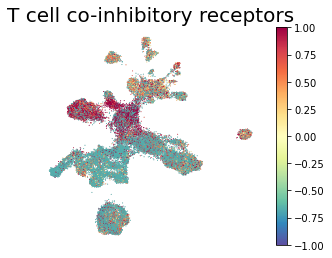

In [ ]:
# zscored
for i,sample in enumerate(sigtype_counts_t):
    fig = plt.figure(figsize=[5 ,4])
    cmap = plt.cm.Spectral_r
    plt.scatter(umap['x'],umap['y'], edgecolors='none', cmap=cmap, c='lightgrey',s=1)
    c = st.zscore(sigtype_counts_t[sample])
    cells = DF_log.index
    plot=plt.scatter(umap.loc[cells,'x'],umap.loc[cells,'y'], edgecolors='none',cmap=cmap, c=c, label=sample,s=1,vmin=-1,vmax=1)
    fig.colorbar(plot)   
    plt.title(sample, fontsize = 20)
    plt.axis('off')

# scVI

In [ ]:
adata

AnnData object with n_obs × n_vars = 57443 × 19000
    obs: 'batch'

In [ ]:
adata.layers["counts"] = adata.X.copy() # preserve counts
sc.pp.normalize_total(adata, target_sum=1e4) #normalize counts/cell

In [ ]:
scvi.data.setup_anndata(adata, layer="counts", batch_key="batch")

INFO     Using batches from adata.obs["batch"]                                               
INFO     No label_key inputted, assuming all cells have same label                           
INFO     Using data from adata.layers["counts"]                                              
INFO     Computing library size prior per batch                                              
INFO     Successfully registered anndata object containing 57443 cells, 19000 vars, 35       
         batches, 1 labels, and 0 proteins. Also registered 0 extra categorical covariates   
         and 0 extra continuous covariates.                                                  
INFO     Please do not further modify adata until model is trained.                          


In [ ]:
#Apply scVI
model = scvi.model.SCVI(adata)

/home/rt2716/anaconda3/lib/python3.8/site-packages/scvi/model/base/_base_model.py:147: UserWarning: Make sure the registered X field in anndata contains unnormalized count data.
  warnings.warn(


In [ ]:
model.train()

GPU available: False, used: False
TPU available: False, using: 0 TPU cores


Epoch 1/139:   0%|          | 0/139 [00:00<?, ?it/s]

/home/rt2716/anaconda3/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:433: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 139/139: 100%|██████████| 139/139 [1:03:00<00:00, 27.20s/it, loss=5.03e+03, v_num=1]


In [ ]:
adata.obsm["X_scVI"] = model.get_latent_representation() #obsm - annotations of observations 
#get_latent_represenation gets the low dimensional representation of each cell


#Save scVI components to a csv file 
scVI=pd.DataFrame(adata.obsm['X_scVI'])
scVI.to_csv('BMEN4480_scVI_components_new.csv')

/home/rt2716/anaconda3/lib/python3.8/site-packages/scvi/model/base/_base_model.py:147: UserWarning: Make sure the registered X field in anndata contains unnormalized count data.
  warnings.warn(


In [ ]:
adata.obsm["scVI_normalized"] = model.get_normalized_expression( library_size=10e4 )

In [ ]:
adata

AnnData object with n_obs × n_vars = 57443 × 19000
    obs: 'batch', '_scvi_batch', '_scvi_labels', '_scvi_local_l_mean', '_scvi_local_l_var'
    uns: '_scvi'
    obsm: 'X_scVI', 'scVI_normalized'
    layers: 'counts'

In [ ]:
sc.pp.neighbors(adata, use_rep="X_scVI")
sc.tl.leiden(adata)
sc.tl.umap(adata)
sc.tl.tsne(adata, use_rep="X_scVI")

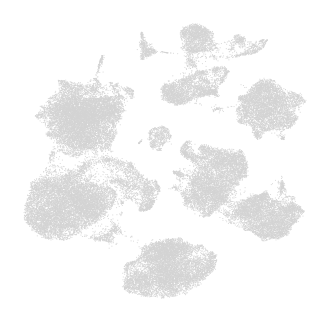

In [ ]:
sc.pl.umap(
    adata,
    frameon=False,
    ncols=1)

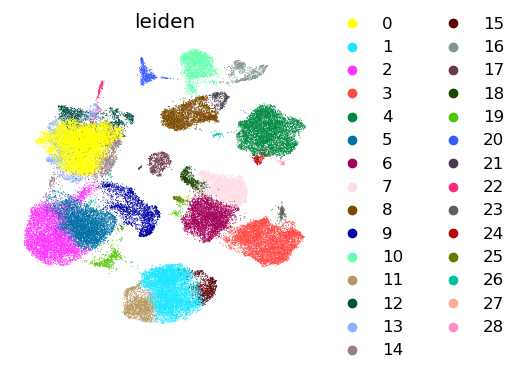

In [ ]:
sc.pl.umap(
    adata, color =['leiden'],
    frameon=False,
    ncols=1)

In [ ]:
#Delete some parts because fle is to large to save (scVI data was saved earlier to a csv file)
del adata.obsm['X_scVI']

In [ ]:
del adata.obsm['scVI_normalized']

In [ ]:
umap = pd.DataFrame(adata.obsm["X_umap"], index = adata.obs['batch'].index, columns = ['x','y'])

In [ ]:
umap

,x,y
T1_AAAGATGTCTTTACAC-0,9.218386,14.086554
T1_ACCGTAATCATGGTCA-0,9.307562,13.330149
T1_CACATAGAGTACATGA-0,9.717191,15.909615
T1_CGTCACTCAAAGCGGT-0,10.182741,14.492432
T1_CTTAGGATCTTGCAAG-0,9.673010,15.847775
...,...,...
N11_GTCACGGCAGCGTTCG-34,11.494987,0.926379
N11_GTGGGTCGTGCCTGGT-34,11.531697,-0.684424
N11_GTGTGCGTCAGGCGAA-34,14.557567,-0.727569
N11_TACTTACCACAACGCC-34,11.860557,-0.277536


In [ ]:
new_index=np.array(umap.index)
for i,index in enumerate(umap.index):
    if index[-2:-1]=='-':
        new_index[i]=index[:-2]
    elif index[-3:-2]=='-':
        new_index[i]=index[:-3]
umap.index=new_index

In [ ]:
umap

,x,y
T1_AAAGATGTCTTTACAC,9.218386,14.086554
T1_ACCGTAATCATGGTCA,9.307562,13.330149
T1_CACATAGAGTACATGA,9.717191,15.909615
T1_CGTCACTCAAAGCGGT,10.182741,14.492432
T1_CTTAGGATCTTGCAAG,9.673010,15.847775
...,...,...
N11_GTCACGGCAGCGTTCG,11.494987,0.926379
N11_GTGGGTCGTGCCTGGT,11.531697,-0.684424
N11_GTGTGCGTCAGGCGAA,14.557567,-0.727569
N11_TACTTACCACAACGCC,11.860557,-0.277536


In [ ]:
umap.to_csv('BMEN4480_Umap_postscvi.csv')

Text(0.5, 1.0, 'Umap (post-scVI) - Cell library size')

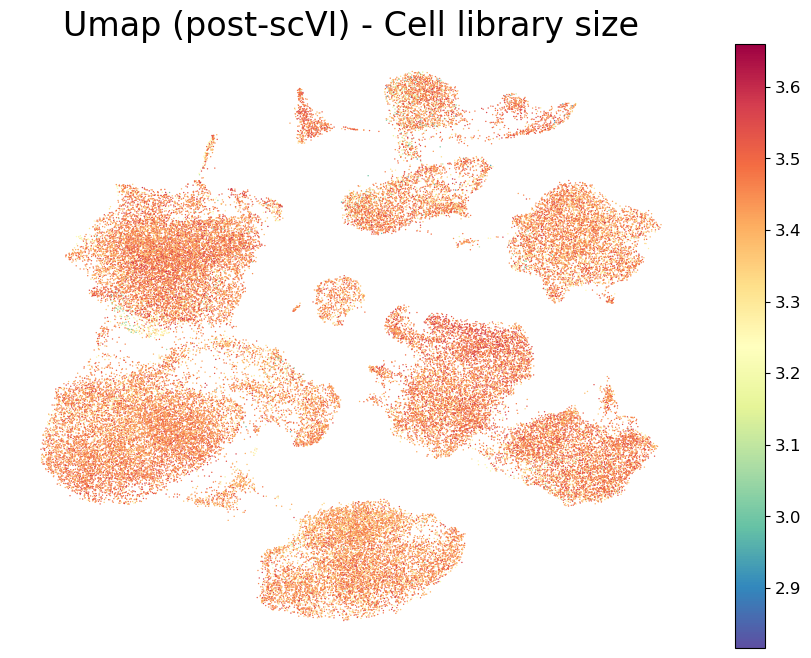

In [ ]:
fig = plt.figure(figsize=[11, 8])
cmap = plt.cm.Spectral_r
total_counts=np.log10(DF.sum(axis=1) + 0.1)
c=total_counts
plt.scatter(umap['x'],umap['y'], edgecolors='none',cmap=cmap, c=c,s=1)
plt.colorbar()
plt.axis('off')
plt.title("Umap (post-scVI) - Cell library size", fontsize = 24)

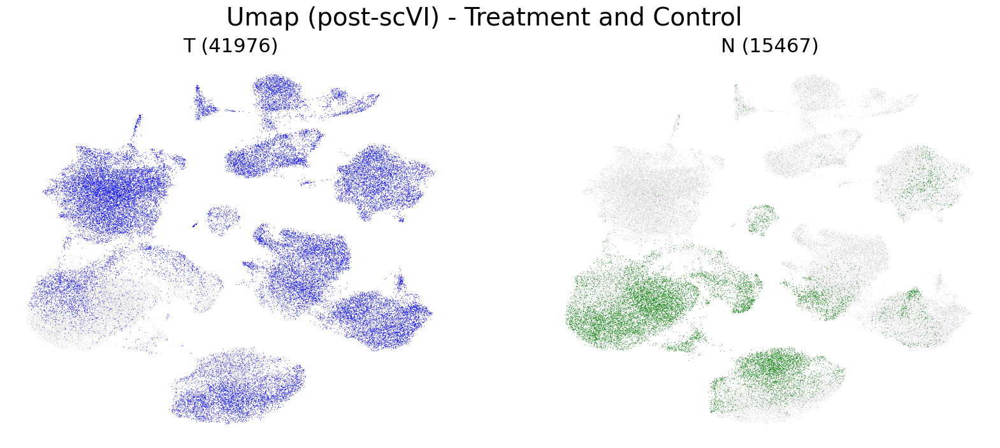

In [ ]:
timepoints = ['T', 'N']

colors=['b','g']
fig = plt.figure(figsize=[20 ,8])
cmap = plt.cm.Spectral_r
i=0
for count, timepoint in enumerate(timepoints):
    ax = fig.add_subplot(1, 2, i+1)
    ax.scatter(umap['x'],umap['y'], edgecolors='none', cmap=cmap, c='lightgrey',s=0.5)
    colored_cells=[]
    for index in umap.index:
        if str(index)[0]==timepoint:
            colored_cells.append(True)
        else:
            colored_cells.append(False)
    colored_cells_no = 0
    for value in colored_cells:
        if value == True:
            colored_cells_no += 1
    ax.scatter(umap.loc[colored_cells,'x'],umap.loc[colored_cells,'y'], edgecolors='none', cmap=cmap, c=colors[count],s=0.5)
    
    ax.set_title(timepoints[i]+' ('+str(colored_cells_no)+')', fontsize = 22)
    ax.set_axis_off()
    plt.suptitle("Umap (post-scVI) - Treatment and Control", fontsize = 28)
    i += 1 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB o

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB o

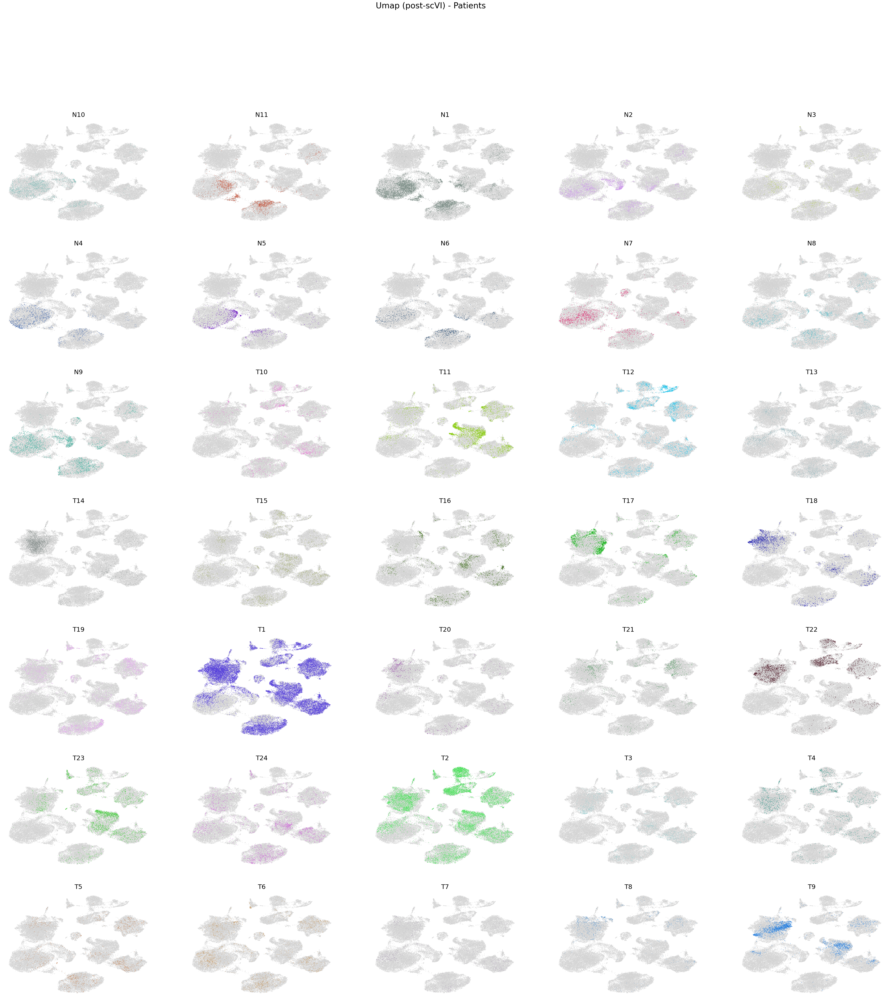

In [ ]:
patients=['N10', 'N11', 'N1', 'N2', 'N3', 'N4', 'N5', 'N6', 'N7',
       'N8', 'N9', 'T10', 'T11', 'T12', 'T13', 'T14', 'T15', 'T16',
       'T17', 'T18', 'T19', 'T1', 'T20', 'T21', 'T22', 'T23', 'T24',
       'T2', 'T3', 'T4', 'T5', 'T6', 'T7', 'T8', 'T9']
colors=random_colors(len(patients))

n_cols = 5; n_rows=7
fig = plt.figure(figsize=[11 * n_cols, 8*n_rows])

cmap = plt.cm.Spectral_r
i=0
for count, patient in enumerate(patients):
    ax = fig.add_subplot(n_rows, n_cols, i+1)
    ax.scatter(umap['x'],umap['y'], edgecolors='none', cmap=cmap, c='lightgrey',s=2)
    colored_cells=umap.index.str.contains(patient)
    ax.scatter(umap.loc[colored_cells,'x'],umap.loc[colored_cells,'y'], edgecolors='none', cmap=cmap, c=colors[count],s=2)
    ax.set_title(patient, fontsize = 22)
    ax.set_axis_off()
    plt.suptitle("Umap (post-scVI) - Patients", fontsize = 28)
    i += 1

# Gene expression - umap post scVI

In [ ]:
umap=pd.read_csv('BMEN4480_Umap_postscvi.csv',index_col=0)

In [ ]:
DF_log=pd.read_pickle('BMEN4480_data_filtered_log_reindex.pkl')

# Markers for PDAC

In [ ]:
#ductal carcinoma - TP53, PTEN, PIK3CA, ERBB2, MYC, Ki67
#Polyak, Kornelia. “Molecular markers for the diagnosis and management of ductal carcinoma in situ.” Journal of the National Cancer Institute.
#Monographs vol. 2010,41 (2010): 210-3. doi:10.1093/jncimonographs/lgq019
#https://www.ncbi.nlm.nih.gov/pmc/articles/PMC2492386/

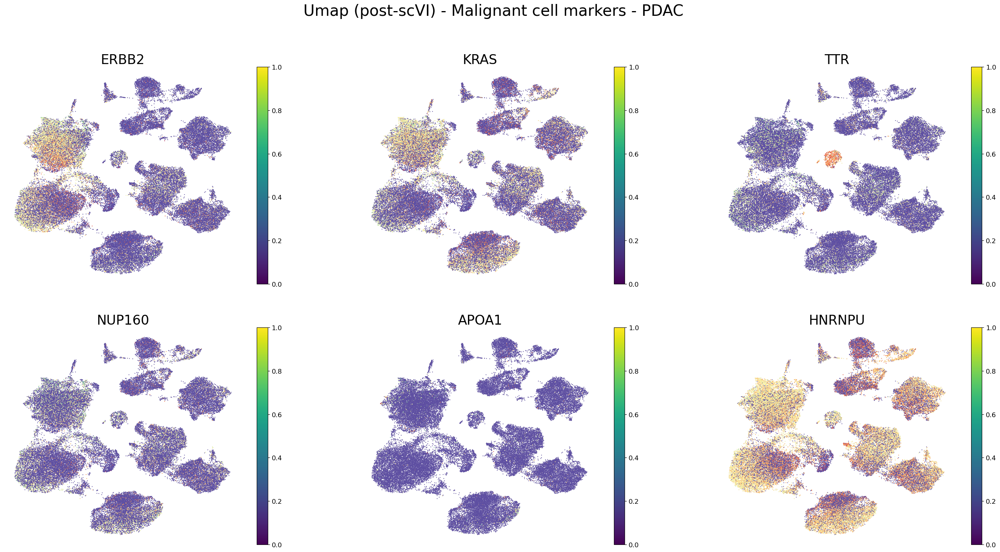

In [ ]:
markers=['ERBB2', 'KRAS','TTR','NUP160','APOA1','HNRNPU']

n_rows=2; n_cols=3
fig = plt.figure(figsize=[11 * n_cols, 8*n_rows])
i = 0
cmap = plt.cm.Spectral_r
for value in markers: 
    ax = fig.add_subplot(n_rows, n_cols, i+1)
    plot = ax.scatter(umap['x'],umap['y'], edgecolors='none', cmap=cmap, c='lightgray', s=2)
    colored_cells=DF_log.loc[:,value].index
    counts = DF_log.loc[:,value]
    ax.scatter(umap.loc[colored_cells,'x'],umap.loc[colored_cells,'y'], edgecolors='none', cmap=cmap, c=counts,s=2)
    ax.set_title(value, fontsize = 24)
    fig.colorbar(plot)
    ax.set_axis_off()
    plt.suptitle("Umap (post-scVI) - Malignant cell markers - PDAC", fontsize = 28)
    i += 1

# Malignant ductal cell markers in PDAC

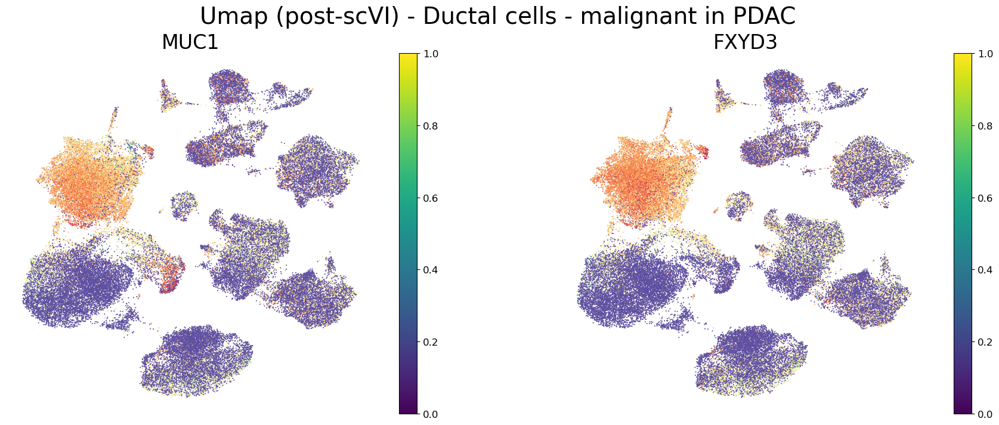

In [ ]:
markers=['MUC1','FXYD3'] #Peng J, Sun BF, Chen CY, Zhou JY, Chen YS, Chen H, Liu L, Huang D, Jiang J, Cui GS, Yang Y, Wang W, Guo D, Dai M, Guo J, Zhang T, Liao Q, Liu Y, Zhao YL, Han DL, Zhao Y, Yang YG, Wu W. Single-cell RNA-seq 
#highlights intra-tumoral heterogeneity and malignant progression in pancreatic ductal

n_rows=1; n_cols=2
fig = plt.figure(figsize=[11 * n_cols, 8*n_rows])
i = 0
cmap = plt.cm.Spectral_r
for value in markers: 
    ax = fig.add_subplot(n_rows, n_cols, i+1)
    plot = ax.scatter(umap['x'],umap['y'], edgecolors='none', cmap=cmap, c='lightgray', s=2)
    colored_cells=DF_log.loc[:,value].index
    counts = DF_log.loc[:,value]
    ax.scatter(umap.loc[colored_cells,'x'],umap.loc[colored_cells,'y'], edgecolors='none', cmap=cmap, c=counts,s=2)
    ax.set_title(value, fontsize = 24)
    fig.colorbar(plot)
    ax.set_axis_off()
    plt.suptitle("Umap (post-scVI) - Ductal cells - malignant in PDAC", fontsize = 28)
    i += 1

In [ ]:
cell_dict = OrderedDict()
cell_dict['Myeloid'] = ['CD14','CD68','APOE','CD81','CD9','CD163','CD1C','FLT3','CD33'] 
cell_dict['NK'] = ['NCAM1','GNLY', 'NCR1', 'KIR2DL3', 'KIR3DL2']#  'KIR2DL4' 'KIR2DL1', 'KIR3DL1', 'KIR3DX1'] 
cell_dict['Macrophage'] = ['CD68','MRC1','MSR1','NRP1','CD82','CD14','CD163','CD86','CD81','C5AR1'] 
cell_dict['Monocyte'] = ['CD33', 'LYZ', 'FCN1', 'CSF3R', 'VCAN']# 'MPO',
cell_dict['B_cell'] = ['CD19','CD40LG','EBF1','TCF3','CD1C','CD19','MS4A1','CR2','CD27',
                       'CD22', 'CD79A', 'CD79B', 'POU2F2', 'CD19', 'MS4A1', 'EBF1', 'PAX5']#IGHD', 'IGHG1', 'IGHM'
cell_dict['HSC'] = ['CD34']
cell_dict['T_cell'] = ['CD3D','CD3E','CD4','CD8A']
cell_dict['Prolif'] = ['MKI67', 'PCNA'] 
cell_dict['Erythroid']=['HBB', 'HBA1', 'HBA2', 'ALAS2', 'SOX6']#'HBD', 'HBM', 'GATA1']

celltype_counts = OrderedDict() #celltype_counts will have an array of normalized counts for each cell type
for key in cell_dict:
    gene_set = cell_dict[key]
    #print(key)
    #print(DF_log.loc[:,gene_set])
    counts_ = np.sum(DF_log.loc[:,gene_set],axis=1) #sum over each row
    counts_ = np.divide(counts_,len(gene_set))
    celltype_counts[key] = counts_

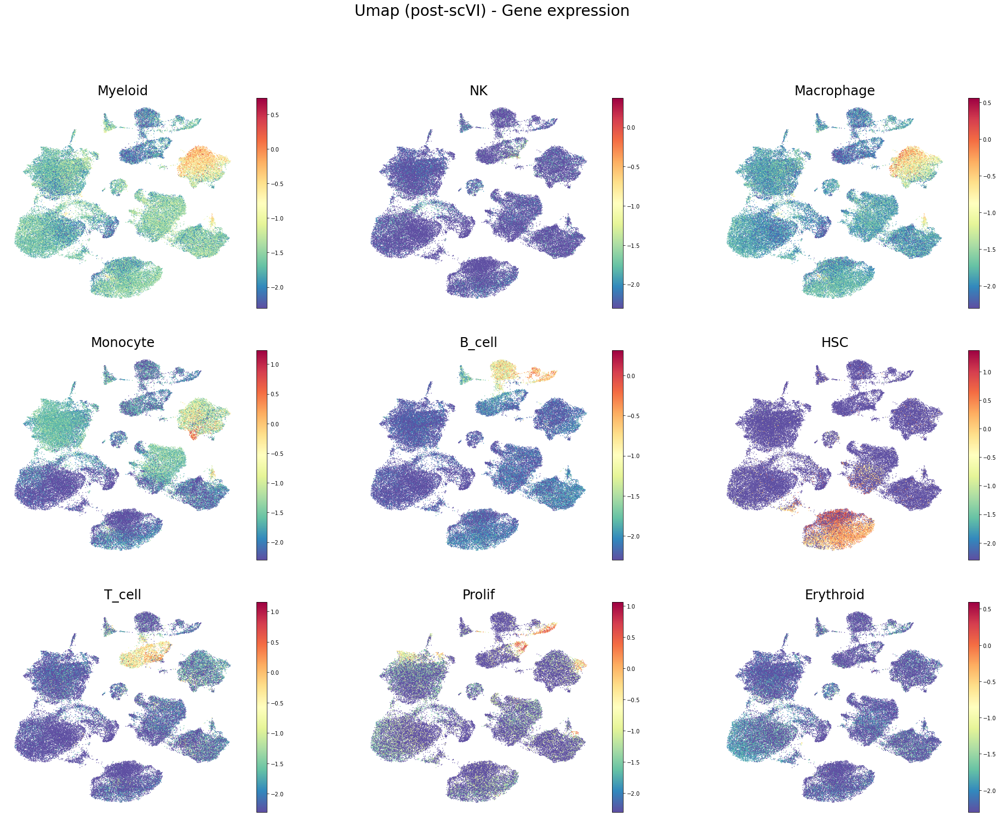

In [ ]:
n_cols = 3; n_rows=3
fig = plt.figure(figsize=[11 * n_cols, 8*n_rows])
i = 0
cmap = plt.cm.Spectral_r
for sample in celltype_counts:
    ax = fig.add_subplot(n_rows, n_cols, i+1)
    c = celltype_counts[sample]#zscore()
    #print(sample)
    #print(c)
    plot = ax.scatter(umap['x'],umap['y'], edgecolors='none',cmap=cmap, c=c, label=sample,s=2)#vmin=-1, vmax=1
    fig.colorbar(plot,ax=ax)
    ax.set_title(sample, fontsize = 24)
    ax.set_axis_off()
    plt.suptitle("Umap (post-scVI) - Gene expression", fontsize = 28)
    i += 1

# Other markers

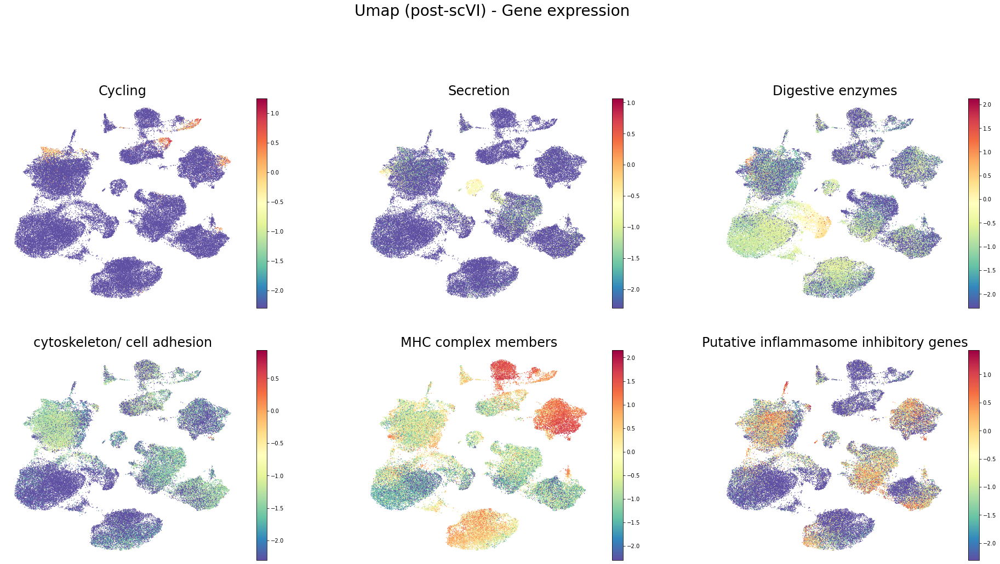

In [ ]:
cell_dict = OrderedDict()
cell_dict['Cycling']=['MKI67']
cell_dict['Secretion']=['FABP1','SCG5']
cell_dict['Digestive enzymes']=['PRSS1','PGC']
cell_dict['cytoskeleton/ cell adhesion']= ['ANXA6', 'TUBB2B',  'CEACAM6']
cell_dict['MHC complex members']=['CD74', 'HLA-DQB1', 'HLA-DRB1']
cell_dict['Putative inflammasome inhibitory genes']=['TMEM176A', 'TMEM176B']

celltype_counts = OrderedDict() #celltype_counts will have an array of normalized counts for each cell type
for key in cell_dict:
    gene_set = cell_dict[key]
    #print(key)
    #print(DF_log.loc[:,gene_set])
    counts_ = np.sum(DF_log.loc[:,gene_set],axis=1) #sum over each row
    counts_ = np.divide(counts_,len(gene_set))
    celltype_counts[key] = counts_
    
n_cols = 3; n_rows=3
fig = plt.figure(figsize=[11 * n_cols, 8*n_rows])
i = 0
cmap = plt.cm.Spectral_r
for sample in celltype_counts:
    ax = fig.add_subplot(n_rows, n_cols, i+1)
    c = celltype_counts[sample]#zscore()
    #print(sample)
    #print(c)
    plot = ax.scatter(umap['x'],umap['y'], edgecolors='none',cmap=cmap, c=c, label=sample,s=2)#vmin=-1, vmax=1
    fig.colorbar(plot,ax=ax)
    ax.set_title(sample, fontsize = 24)
    ax.set_axis_off()
    plt.suptitle("Umap (post-scVI) - Gene expression", fontsize = 28)
    i += 1

# Subtypes of T cells

In [ ]:
t1=pd.read_csv('T_Cell_markers_jessie.csv')
t2=pd.read_csv('tcell_signatures.csv')
all_tcell_sign=pd.concat([t1,t2])

selected_signatures=['Activated T cells', 'Na�ve T cells', 'T effector cell',
'Exhausted T cells','Terminally Differentiated','CD8 T Cell Activation','TCell Exhaustion',
'Effector cell cytotoxicity','T cell co-inhibitory receptors']

In [ ]:
signature_dict_t = OrderedDict()
weights_dict = OrderedDict()
for signature in selected_signatures:
    df_signatures = all_tcell_sign[signature]
    df_signatures = df_signatures.dropna()
    
    weights_array=[]
    new_list_t=[]
    for gene in df_signatures:
        #print(gene)
        if ((str(gene))[-1:]=='-') and ((str(gene))[:-1] in DF_log.columns):
            #print('yes','1',gene)
            new_list_t.append((str(gene))[:-1])
            weights_array.append(-1)
        elif ((str(gene))[-1:]=='+') and ((str(gene))[:-1] in DF_log.columns):
            #print('yes','2',gene)
            new_list_t.append((str(gene))[:-1])
            weights_array.append(1)
        elif str(gene) in DF_log.columns:
            #print('yes','3',gene)
            new_list_t.append(str(gene))
            weights_array.append(1)
    weights_dict[signature] = weights_array        
    signature_dict_t[signature] = new_list_t

In [ ]:
sigtype_counts_t = OrderedDict() 
for key in signature_dict_t:
    #print(key)
    gene_set_t = signature_dict_t[key]
    counts_t = np.sum(np.multiply((DF_log-DF_log.loc['T1_AAAGATGTCTTTACAC','AP006222.1']).loc[:,gene_set_t],weights_dict[key]),axis=1) #sum over each row
    counts_t = np.divide(counts_t,len(gene_set_t))
    #print(counts_t.shape)
    sigtype_counts_t[key] = counts_t

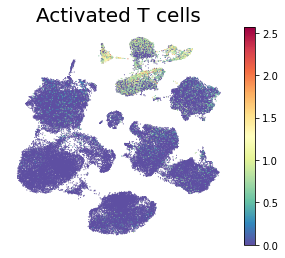

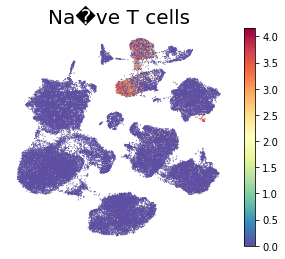

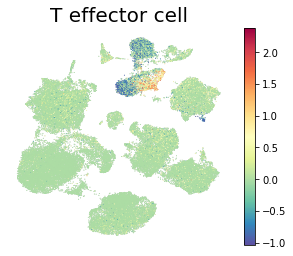

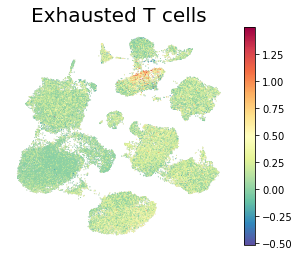

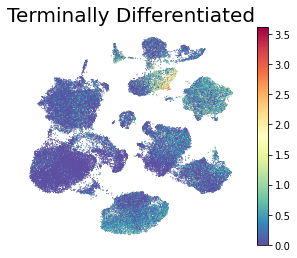

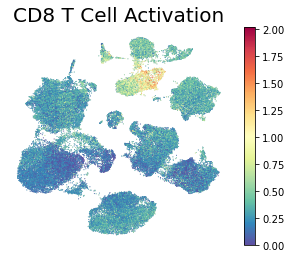

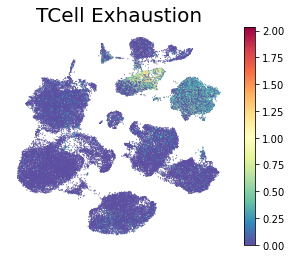

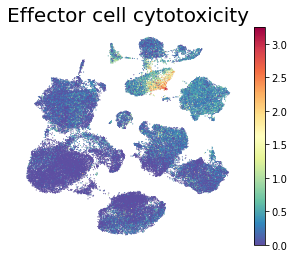

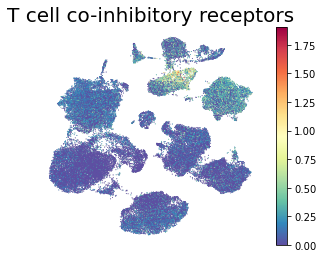

In [ ]:
#not zscored
for i,sample in enumerate(sigtype_counts_t):
    fig = plt.figure(figsize=[5 ,4])
    cmap = plt.cm.Spectral_r
    plt.scatter(umap['x'],umap['y'], edgecolors='none', cmap=cmap, c='lightgrey',s=1)
    c = sigtype_counts_t[sample]#zscore()
    cells = DF_log.index
    plot=plt.scatter(umap.loc[cells,'x'],umap.loc[cells,'y'], edgecolors='none',cmap=cmap, c=c, label=sample,s=1)
    fig.colorbar(plot)   
    plt.title(sample, fontsize = 20)
    plt.axis('off')

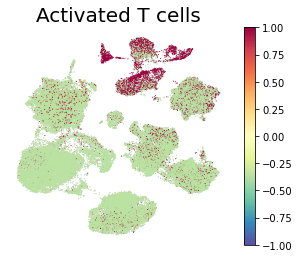

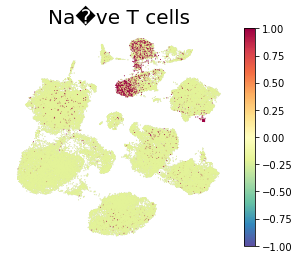

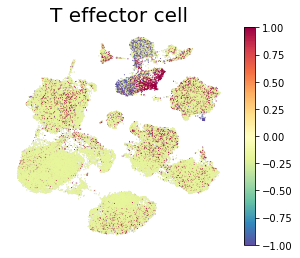

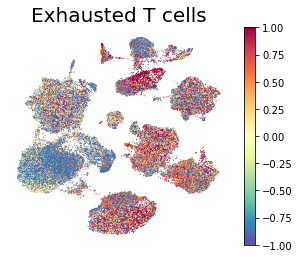

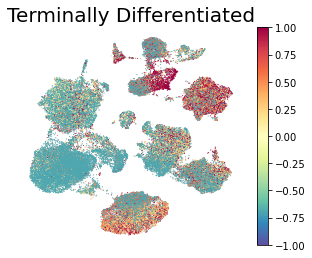

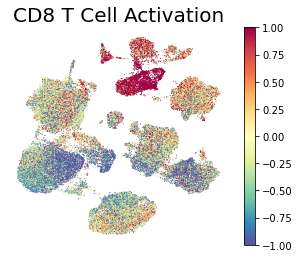

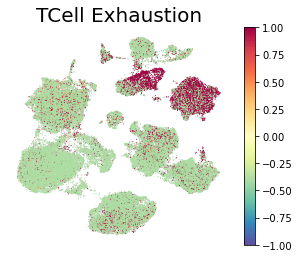

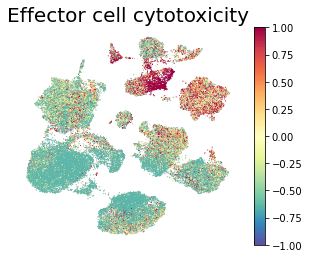

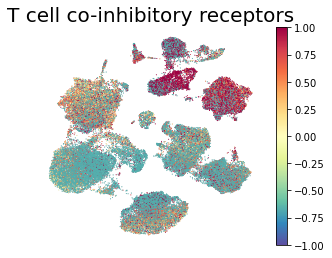

In [ ]:
# zscored
for i,sample in enumerate(sigtype_counts_t):
    fig = plt.figure(figsize=[5 ,4])
    cmap = plt.cm.Spectral_r
    plt.scatter(umap['x'],umap['y'], edgecolors='none', cmap=cmap, c='lightgrey',s=1)
    c = st.zscore(sigtype_counts_t[sample])
    cells = DF_log.index
    plot=plt.scatter(umap.loc[cells,'x'],umap.loc[cells,'y'], edgecolors='none',cmap=cmap, c=c, label=sample,s=1,vmin=-1,vmax=1)
    fig.colorbar(plot)   
    plt.title(sample, fontsize = 20)
    plt.axis('off')

# Prepare input data for inferCNV

In [ ]:
#input:
#a raw counts matrix of single-cell RNA-Seq expression (genes vs. cells)
#an annotations file which indicates which cells are tumor vs. normal. (use T cells as normal cells)
#a gene/chromosome positions file -- got it from Yiping Wang (Izar Lab)

# Clustering 

# used with gene expression to identify T cells

In [ ]:
DF_log=pd.read_pickle('BMEN4480_data_filtered_log_reindex.pkl')

In [ ]:
umap=pd.read_csv('BMEN4480_Umap_postscvi.csv',index_col=0)

In [ ]:
import random
##function to generate random colors for coloring clusters
def random_colors(n): #n is the number of colors you need to generate
    color_set = np.zeros((n,3))
    for i in range(n):
        r = random.uniform(0, 1)
        b = random.uniform(0, 1)
        g = random.uniform(0, 1)
        color_set[i] = [r,b,g]
    return color_set

matplotlib.rcParams['figure.figsize'] = [4, 4]
matplotlib.rcParams['figure.dpi'] = 100
plt.rcParams.update({'font.size': 12})

In [ ]:
pca = PCA(n_components=20) 
pca_projections = pd.DataFrame(pca.fit_transform(DF_log), index = DF_log.index)

In [ ]:
pca_ad=ad.AnnData(pca_projections)

C:\Users\19292\anaconda3\lib\site-packages\anndata\_core\anndata.py:120: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [ ]:
#knn graph
knn = kneighbors_graph(pca_projections,n_neighbors = 25, mode='distance', metric = 'minkowski', include_self = True)
communities, graph, Q = phenograph.cluster(knn)
n_cluster_knn = np.amax(communities)

Using neighbor information from provided graph, rather than computing neighbors directly
Jaccard graph constructed in 10.348950624465942 seconds
Wrote graph to binary file in 0.970292329788208 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.927676
After 15 runs, maximum modularity is Q = 0.92881
Louvain completed 35 runs in 92.91366815567017 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 108.31298470497131 seconds


In [ ]:
DF_log['cluster_number']=communities

In [ ]:
DF_log.to_pickle('BMEN4480_data_log_with_clusters.pkl')

(-7.639989614999999, 17.919309315, -8.96468135, 20.46818035)

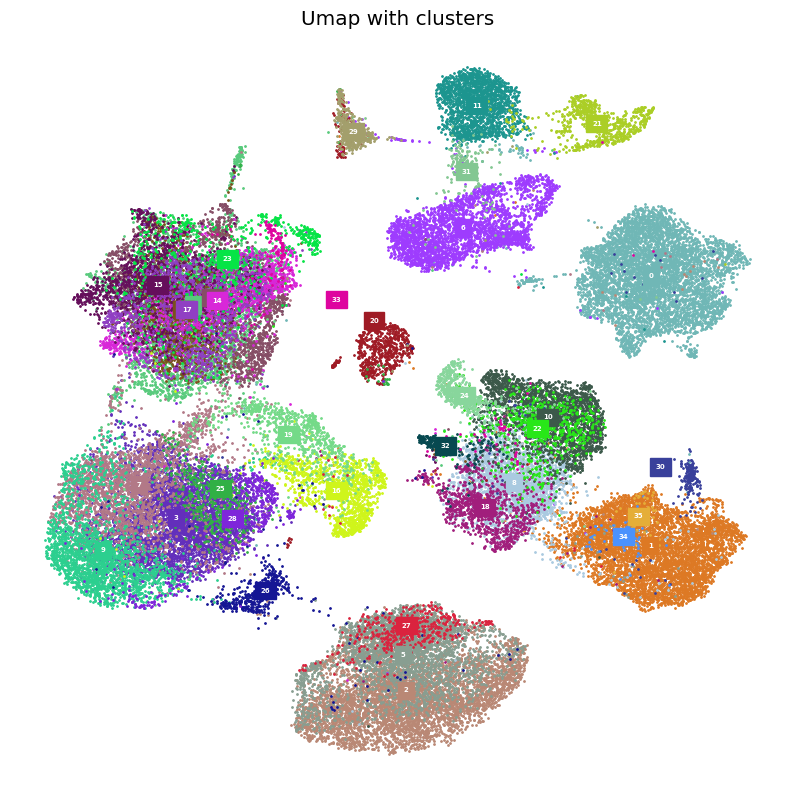

In [ ]:
plt.figure(figsize=(10,10))
color_set_clusters = random_colors(n_cluster_knn + 2)
#loop through labels and plot each cluster
for cluster in range(n_cluster_knn+1):

    #add data points 
    cells = umap[communities == cluster].index
    #print(communities==cluster)
    plt.scatter(x=umap.loc[cells, 'x'], 
                y=umap.loc[cells, 'y'], s=1,
                color=color_set_clusters[cluster], 
                alpha=1)
    
    #add label
    plt.annotate(cluster, 
                 umap.loc[cells,['x','y']].mean(),
                 horizontalalignment='center',
                 verticalalignment='center',
                 size=5, weight = 'bold',
                 color='white',
                 backgroundcolor=color_set_clusters[cluster]) 
    plt.title("Umap with clusters")
plt.axis('off')

In [ ]:
DF_log=pd.read_pickle('BMEN4480_data_log_with_clusters.pkl')

In [ ]:
DF_log

,AP006222.1,AL669831.1,AL669831.5,LINC00115,FAM41C,LINC02593,SAMD11,NOC2L,KLHL17,PLEKHN1,...,AC020634.1,ROPN1B,AC010207.1,AC072039.2,WWTR1-AS1,WDR49,LINC00578,AC007823.1,CCDC39,cluster_number
T1_AAAGATGTCTTTACAC,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,...,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,6
T1_ACCGTAATCATGGTCA,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,0.649441,-2.302585,-2.302585,-2.302585,...,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,6
T1_CACATAGAGTACATGA,-2.302585,-2.302585,-0.267167,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,...,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,6
T1_CGTCACTCAAAGCGGT,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,...,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,6
T1_CTTAGGATCTTGCAAG,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-0.186991,-2.302585,-2.302585,...,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
N11_GTCACGGCAGCGTTCG,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,...,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,1
N11_GTGGGTCGTGCCTGGT,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,...,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,1
N11_GTGTGCGTCAGGCGAA,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,...,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,1
N11_TACTTACCACAACGCC,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,...,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,-2.302585,1


In [ ]:
df=pd.DataFrame(DF_log['cluster_number'],index=DF_log.index)

In [ ]:
for index in df.index:
    cluster=df.loc[index,'cluster_number']
    if cluster == 6:
        df.loc[index,'cluster_number'] = 'normal'
    else:
        df.loc[index,'cluster_number'] = 'tumor'
df

,cluster_number
T1_AAAGATGTCTTTACAC,normal
T1_ACCGTAATCATGGTCA,normal
T1_CACATAGAGTACATGA,normal
T1_CGTCACTCAAAGCGGT,normal
T1_CTTAGGATCTTGCAAG,normal
...,...
N11_GTCACGGCAGCGTTCG,tumor
N11_GTGGGTCGTGCCTGGT,tumor
N11_GTGTGCGTCAGGCGAA,tumor
N11_TACTTACCACAACGCC,tumor


In [ ]:
np.unique(df['cluster_number'])

array(['normal', 'tumor'], dtype=object)

In [ ]:
df

In [ ]:
df.to_csv('BMEN4480_annotation_file_inferCNV_new.csv',header=False)

In [ ]:
df.to_csv('BMEN4480_annotation_file_inferCNV_new.tsv', sep="\t",header=False)

In [ ]:
DF=pd.read_pickle('BMEN4480_data.pkl')

In [ ]:
DF

,AP006222.1,AL669831.1,AL669831.5,LINC00115,FAM41C,LINC02593,SAMD11,NOC2L,KLHL17,PLEKHN1,...,NECTIN3-AS1,AC020634.1,ROPN1B,AC010207.1,AC072039.2,WWTR1-AS1,WDR49,LINC00578,AC007823.1,CCDC39
T2_AAAGATGAGCTTCGCG,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
T2_AAATGCCCAAGCCGCT,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.474931,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
T2_AAGGCAGCAGGGAGAG,0.139459,0.0,0.0,0.139459,0.0,0.0,0.0,0.139459,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
T2_ACACTGAAGACCACGA,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
T2_ACACTGATCCTTTCTC,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
N11_GTCACGGCAGCGTTCG,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
N11_GTGGGTCGTGCCTGGT,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
N11_GTGTGCGTCAGGCGAA,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
N11_TACTTACCACAACGCC,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
umap=pd.read_csv('BMEN4480_Umap_postscvi.csv',index_col=0)

In [ ]:
umap

,x,y
T1_AAAGATGTCTTTACAC,9.218386,14.086554
T1_ACCGTAATCATGGTCA,9.307562,13.330149
T1_CACATAGAGTACATGA,9.717191,15.909615
T1_CGTCACTCAAAGCGGT,10.182741,14.492432
T1_CTTAGGATCTTGCAAG,9.673010,15.847775
...,...,...
N11_GTCACGGCAGCGTTCG,11.494988,0.926379
N11_GTGGGTCGTGCCTGGT,11.531697,-0.684424
N11_GTGTGCGTCAGGCGAA,14.557567,-0.727569
N11_TACTTACCACAACGCC,11.860557,-0.277536


In [ ]:
new_index=[]
for index in umap.index:
    new_index.append(index)
DF=DF.reindex(new_index)

In [ ]:
DF

,AP006222.1,AL669831.1,AL669831.5,LINC00115,FAM41C,LINC02593,SAMD11,NOC2L,KLHL17,PLEKHN1,...,NECTIN3-AS1,AC020634.1,ROPN1B,AC010207.1,AC072039.2,WWTR1-AS1,WDR49,LINC00578,AC007823.1,CCDC39
T1_AAAGATGTCTTTACAC,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
T1_ACCGTAATCATGGTCA,0.0,0.0,0.000000,0.0,0.0,0.0,1.530801,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
T1_CACATAGAGTACATGA,0.0,0.0,0.709489,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
T1_CGTCACTCAAAGCGGT,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
T1_CTTAGGATCTTGCAAG,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.760134,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
N11_GTCACGGCAGCGTTCG,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
N11_GTGGGTCGTGCCTGGT,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
N11_GTGTGCGTCAGGCGAA,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
N11_TACTTACCACAACGCC,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
DF_transpose=DF.transpose()
DF_transpose

,T1_AAAGATGTCTTTACAC,T1_ACCGTAATCATGGTCA,T1_CACATAGAGTACATGA,T1_CGTCACTCAAAGCGGT,T1_CTTAGGATCTTGCAAG,T1_GGTGTTACAGTTCCCT,T1_GTTAAGCCAGTCTTCC,T1_AACACGTAGAAGGTGA,T1_AACACGTGTCATATCG,T1_AAGGAGCAGTGGTAGC,...,N11_CTGATAGTCTGCGGCA,N11_GACGGCTGTTACGGAG,N11_GCATGCGGTTGATTCG,N11_GGGTCTGCATAAGACA,N11_GTAACGTTCAGATAAG,N11_GTCACGGCAGCGTTCG,N11_GTGGGTCGTGCCTGGT,N11_GTGTGCGTCAGGCGAA,N11_TACTTACCACAACGCC,N11_TCGCGTTGTGTAATGA
AP006222.1,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.375664,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0
AL669831.1,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0
AL669831.5,0.0,0.0,0.709489,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0
LINC00115,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.0,0.0,1.834242,0.0,0.0,0.0,0.0,0.0
FAM41C,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
WWTR1-AS1,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0
WDR49,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0
LINC00578,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0
AC007823.1,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0


In [ ]:
DF_transpose.to_csv('BMEN4480_count_matrix_inferCNV.csv')

In [ ]:
DF_transpose.to_csv('BMEN4480_count_matrix_inferCNV.tsv',sep="\t")

In [ ]:
scvi_comp=pd.read_csv('BMEN4480_scVI_components_new.csv',index_col=0)

In [ ]:
scvi_comp

,0,1,2,3,4,5,6,7,8,9
0,1.189815,-0.313634,0.886464,0.999586,-1.426459,-0.700810,-0.012602,0.062456,2.431499,-2.293812
1,0.710519,-0.254286,1.496843,0.654783,-1.172975,-0.640418,-0.577637,0.392772,2.662388,-0.888884
2,0.232791,-0.038734,0.450825,0.177438,-0.874784,-0.055586,-3.027546,-0.075981,0.932227,-3.023388
3,-0.260078,-1.531519,1.329643,1.528925,-3.056078,-0.347131,-0.521308,-0.188426,2.536563,-1.444941
4,0.495184,0.054836,0.451482,0.289350,-0.941521,0.048865,-3.072856,-0.162355,0.853238,-2.937138
...,...,...,...,...,...,...,...,...,...,...
57438,1.096857,-2.585498,-0.095942,1.678720,1.273424,0.680616,1.666650,-0.922355,0.043462,-0.443750
57439,3.111883,-2.439081,0.698511,0.899289,0.191406,0.692841,2.533550,-0.539839,0.547857,0.738136
57440,0.220178,-1.925571,-0.317345,2.107070,0.909253,0.276211,0.914477,1.565456,2.152138,1.556374
57441,2.205932,-2.507166,0.243835,1.448204,0.128984,0.848118,2.299555,-0.638818,0.963054,-0.189803


In [ ]:
new=[]
for index in umap.index:
    new.append(index)
scvi_comp.index=new

In [ ]:
scvi_comp

,0,1,2,3,4,5,6,7,8,9
T1_AAAGATGTCTTTACAC,1.189815,-0.313634,0.886464,0.999586,-1.426459,-0.700810,-0.012602,0.062456,2.431499,-2.293812
T1_ACCGTAATCATGGTCA,0.710519,-0.254286,1.496843,0.654783,-1.172975,-0.640418,-0.577637,0.392772,2.662388,-0.888884
T1_CACATAGAGTACATGA,0.232791,-0.038734,0.450825,0.177438,-0.874784,-0.055586,-3.027546,-0.075981,0.932227,-3.023388
T1_CGTCACTCAAAGCGGT,-0.260078,-1.531519,1.329643,1.528925,-3.056078,-0.347131,-0.521308,-0.188426,2.536563,-1.444941
T1_CTTAGGATCTTGCAAG,0.495184,0.054836,0.451482,0.289350,-0.941521,0.048865,-3.072856,-0.162355,0.853238,-2.937138
...,...,...,...,...,...,...,...,...,...,...
N11_GTCACGGCAGCGTTCG,1.096857,-2.585498,-0.095942,1.678720,1.273424,0.680616,1.666650,-0.922355,0.043462,-0.443750
N11_GTGGGTCGTGCCTGGT,3.111883,-2.439081,0.698511,0.899289,0.191406,0.692841,2.533550,-0.539839,0.547857,0.738136
N11_GTGTGCGTCAGGCGAA,0.220178,-1.925571,-0.317345,2.107070,0.909253,0.276211,0.914477,1.565456,2.152138,1.556374
N11_TACTTACCACAACGCC,2.205932,-2.507166,0.243835,1.448204,0.128984,0.848118,2.299555,-0.638818,0.963054,-0.189803


In [ ]:
clusters=pd.read_csv('BMEN4480_annotation_file_inferCNV.csv',index_col=0)

In [ ]:
clusters

,cluster_number
T1_AAAGATGTCTTTACAC,normal
T1_ACCGTAATCATGGTCA,normal
T1_CACATAGAGTACATGA,tumor
T1_CGTCACTCAAAGCGGT,normal
T1_CTTAGGATCTTGCAAG,tumor
...,...
N11_GTCACGGCAGCGTTCG,tumor
N11_GTGGGTCGTGCCTGGT,tumor
N11_GTGTGCGTCAGGCGAA,tumor
N11_TACTTACCACAACGCC,tumor


In [ ]:
tumor_clusters=[20,23,33,15,17,14,4,12,13]

In [ ]:
umap=pd.read_csv('BMEN4480_Umap_postscvi.csv',index_col=0)

In [ ]:
communities=DF_log['cluster_number']

(-7.639989614999999, 17.919309315, -8.96468135, 20.46818035)

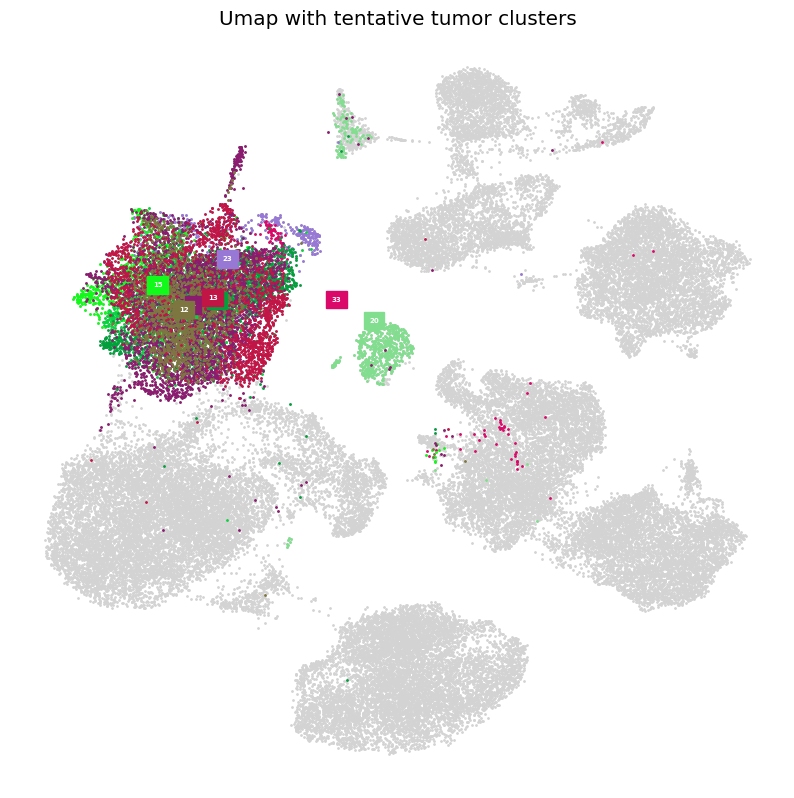

In [ ]:
plt.figure(figsize=(10,10))
color_set_clusters = random_colors(12)
#loop through labels and plot each cluster
i=0
plt.scatter(x=umap['x'],y=umap['y'],color='lightgray',s=1)
for cluster in tumor_clusters:

    #add data points 
    cells = umap[communities == cluster].index
    #print(communities==cluster)
    plt.scatter(x=umap.loc[cells, 'x'], 
                y=umap.loc[cells, 'y'], s=1,
                color=color_set_clusters[i], 
                alpha=1)
    
    #add label
    plt.annotate(cluster, 
                 umap.loc[cells,['x','y']].mean(),
                 horizontalalignment='center',
                 verticalalignment='center',
                 size=5, weight = 'bold',
                 color='white',
                 backgroundcolor=color_set_clusters[i]) 
    i+=1
    plt.title("Umap with tentative tumor clusters")
plt.axis('off')

# infercnvpy

In [ ]:
#https://icbi-lab.github.io/infercnvpy/infercnv.html

In [ ]:
import infercnvpy as cnv

In [ ]:
DF_log=pd.read_pickle('BMEN4480_data_filtered_log_reindex.pkl')

In [ ]:
umap=pd.read_csv('BMEN4480_Umap_postscvi.csv',index_col=0)

In [ ]:
adata = sc.AnnData(DF_log)

In [ ]:
adata

AnnData object with n_obs × n_vars = 57443 × 19000

In [ ]:
#file with gene coord: https://www.gencodegenes.org/human/
cnv.io.genomic_position_from_gtf('gencode.v40.annotation.gtf.gz', adata=adata, gtf_gene_id='gene_name', adata_gene_id=None, inplace=True)

INFO:root:Extracted GTF attributes: ['gene_id', 'gene_name']


In [ ]:
adata.obsm['X_umap']=umap

In [ ]:
adata

AnnData object with n_obs × n_vars = 57443 × 19000
    var: 'chromosome', 'start', 'end', 'gene_id', 'gene_name'
    obsm: 'X_umap'

In [ ]:
DF_log=pd.read_pickle('BMEN4480_data_log_with_clusters.pkl')
for index in DF_log.index:
    cluster=DF_log.loc[index,'cluster_number']
    if cluster==6:
        adata.obs.loc[index,'cell_type']='normal'
    else:
        adata.obs.loc[index,'cell_type']='tumor'

In [ ]:
adata

AnnData object with n_obs × n_vars = 57443 × 19000
    obs: 'cell_type'
    var: 'chromosome', 'start', 'end', 'gene_id', 'gene_name'
    obsm: 'X_umap'

In [ ]:
# We provide cluster 6 - T cells - as "normal cells".
cnv.tl.infercnv(
    adata,
    reference_key="cell_type",
    reference_cat="normal",
    window_size=250,
)

  0%|          | 0/12 [00:00<?, ?it/s]

... storing 'cell_type' as categorical


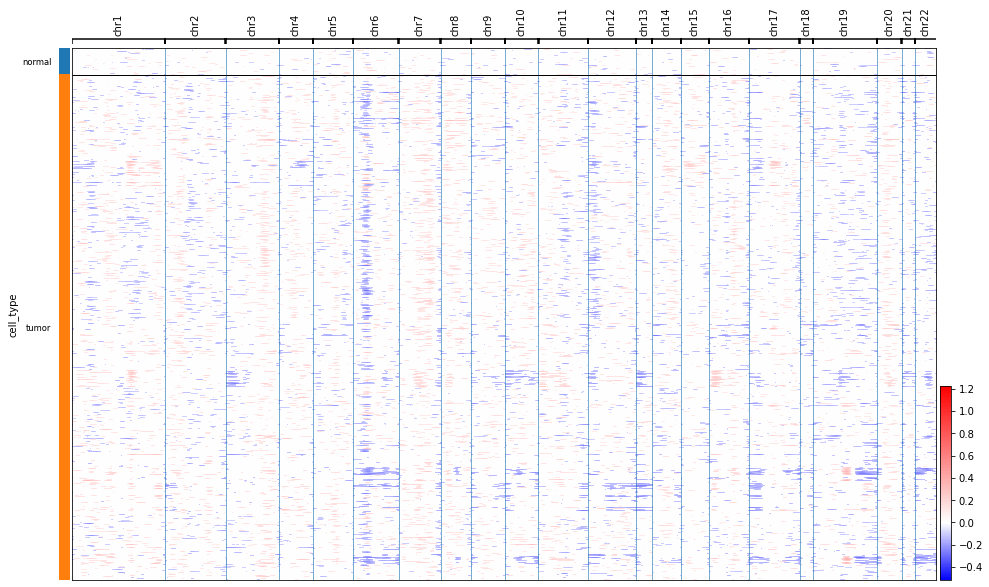

In [ ]:
cnv.pl.chromosome_heatmap(adata, groupby="cell_type")

In [ ]:
adata.obs['clusters']=DF_log['cluster_number']

In [ ]:
adata

AnnData object with n_obs × n_vars = 57443 × 19000
    obs: 'cell_type', 'clusters'
    var: 'chromosome', 'start', 'end', 'gene_id', 'gene_name'
    uns: 'cnv'
    obsm: 'X_umap', 'X_cnv'

(-7.639989614999999, 17.919309315, -8.96468135, 20.46818035)

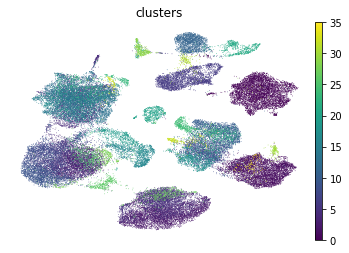

In [ ]:
sc.pl.umap(adata, color="clusters", show=False)
plt.axis('off')

In [ ]:
cnv.tl.pca(adata)
cnv.pp.neighbors(adata)
cnv.tl.leiden(adata)

In [ ]:
cnv.tl.cnv_score(adata)

         Falling back to preprocessing with `sc.pp.pca` and default params.
categories: 0, 1, 2, etc.
var_group_labels: chr1, chr2, chr3, etc.


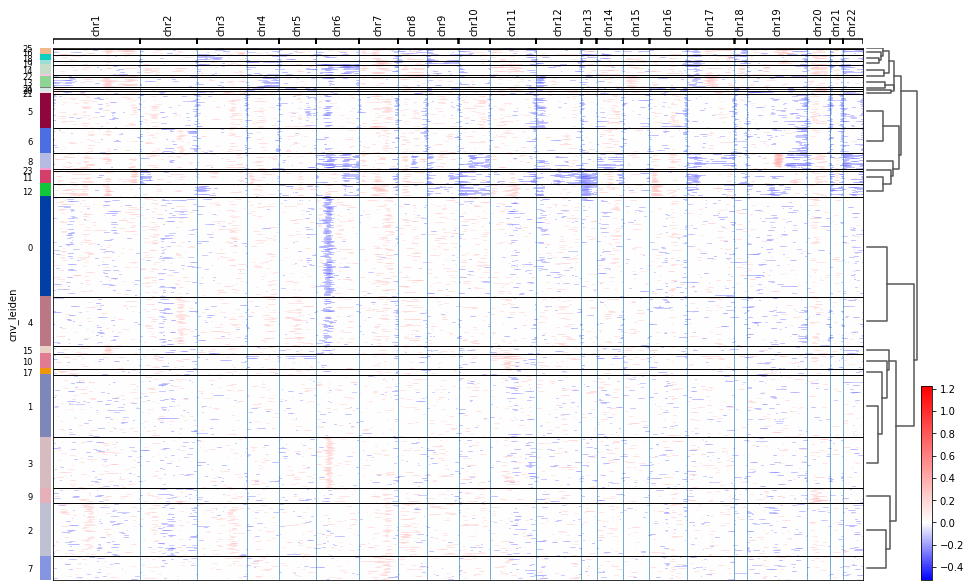

In [ ]:
cnv.pl.chromosome_heatmap(adata, groupby="cnv_leiden", dendrogram=True)

In [ ]:
adata

AnnData object with n_obs × n_vars = 57443 × 19000
    obs: 'cell_type', 'clusters', 'cnv_leiden', 'cnv_score'
    var: 'chromosome', 'start', 'end', 'gene_id', 'gene_name'
    uns: 'cnv', 'cnv_neighbors', 'leiden'
    obsm: 'X_umap', 'X_cnv', 'X_cnv_pca'
    obsp: 'cnv_neighbors_distances', 'cnv_neighbors_connectivities'

(-7.639989614999999, 17.919309315, -8.96468135, 20.46818035)

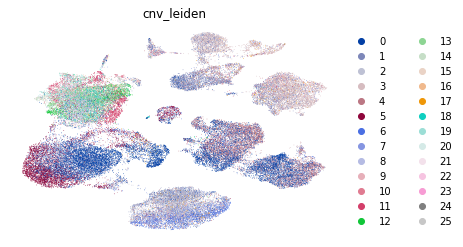

In [ ]:
sc.pl.umap(adata,color="cnv_leiden",show=False)
plt.axis('off')

(-7.639989614999999, 17.919309315, -8.96468135, 20.46818035)

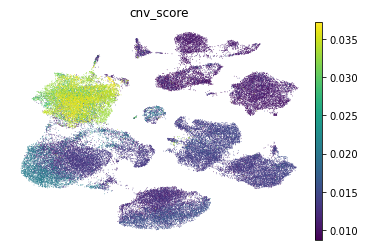

In [ ]:
sc.pl.umap(adata, color="cnv_score", show=False)
plt.axis('off')

In [ ]:
#Combining the annotation made from gene expression and from infercnvpy
tumor_clusters=[23,33,15,17,14,4,12,13]

(-7.639989614999999, 17.919309315, -8.96468135, 20.46818035)

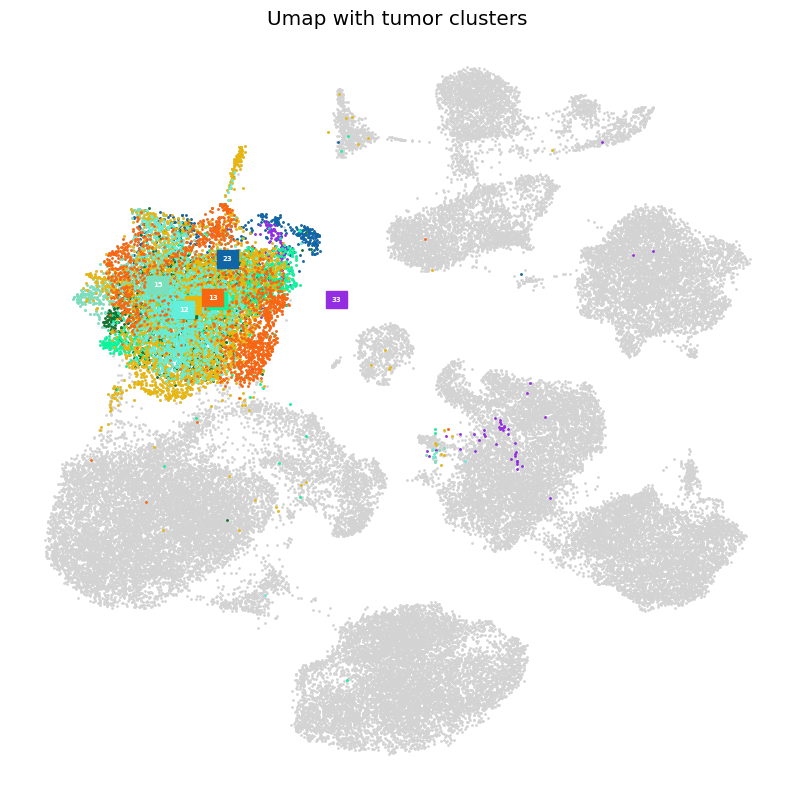

In [ ]:
plt.figure(figsize=(10,10))
color_set_clusters = random_colors(12)
#loop through labels and plot each cluster
i=0
plt.scatter(x=umap['x'],y=umap['y'],color='lightgray',s=1)
for cluster in tumor_clusters:

    #add data points 
    cells = umap[communities == cluster].index
    #print(communities==cluster)
    plt.scatter(x=umap.loc[cells, 'x'], 
                y=umap.loc[cells, 'y'], s=1,
                color=color_set_clusters[i], 
                alpha=1)
    
    #add label
    plt.annotate(cluster, 
                 umap.loc[cells,['x','y']].mean(),
                 horizontalalignment='center',
                 verticalalignment='center',
                 size=5, weight = 'bold',
                 color='white',
                 backgroundcolor=color_set_clusters[i]) 
    i+=1
    plt.title("Umap with tumor clusters")
plt.axis('off')

# Put together file (use as input for the ML model)

In [ ]:
scvi_comp=pd.read_csv('BMEN4480_scVI_components_new.csv',index_col=0)
new=[]
for index in DF_log.index:
    new.append(index)
scvi_comp.index=new

In [ ]:
tumor_clusters=[23,33,15,17,14,4,12,13]

In [ ]:
for index in DF_log.index:
    cluster=DF_log.loc[index,'cluster_number']
    if cluster in tumor_clusters:
        scvi_comp.loc[index,'cell_type']='tumor'
    else:
        scvi_comp.loc[index,'cell_type']='normal'

In [ ]:
scvi_comp

,0,1,2,3,4,5,6,7,8,9,cell_type
T1_AAAGATGTCTTTACAC,1.189815,-0.313634,0.886464,0.999586,-1.426459,-0.700810,-0.012602,0.062456,2.431499,-2.293812,normal
T1_ACCGTAATCATGGTCA,0.710519,-0.254286,1.496843,0.654783,-1.172975,-0.640418,-0.577637,0.392772,2.662388,-0.888884,normal
T1_CACATAGAGTACATGA,0.232791,-0.038734,0.450825,0.177438,-0.874784,-0.055586,-3.027546,-0.075981,0.932227,-3.023388,normal
T1_CGTCACTCAAAGCGGT,-0.260078,-1.531519,1.329643,1.528925,-3.056078,-0.347131,-0.521308,-0.188426,2.536563,-1.444941,normal
T1_CTTAGGATCTTGCAAG,0.495184,0.054836,0.451482,0.289350,-0.941521,0.048865,-3.072856,-0.162355,0.853238,-2.937138,normal
...,...,...,...,...,...,...,...,...,...,...,...
N11_GTCACGGCAGCGTTCG,1.096857,-2.585498,-0.095942,1.678720,1.273424,0.680616,1.666650,-0.922355,0.043462,-0.443750,normal
N11_GTGGGTCGTGCCTGGT,3.111883,-2.439081,0.698511,0.899289,0.191406,0.692841,2.533550,-0.539839,0.547857,0.738136,normal
N11_GTGTGCGTCAGGCGAA,0.220178,-1.925571,-0.317345,2.107070,0.909253,0.276211,0.914477,1.565456,2.152138,1.556374,normal
N11_TACTTACCACAACGCC,2.205932,-2.507166,0.243835,1.448204,0.128984,0.848118,2.299555,-0.638818,0.963054,-0.189803,normal


In [ ]:
np.unique(scvi_comp['cell_type'])

array(['normal', 'tumor'], dtype=object)

In [ ]:
n=0
for value in scvi_comp['cell_type']:
    if value=='tumor':
        n+=1
n

11344

In [ ]:
scvi_comp.to_csv('BMEN4480_scvi_comp_cell_types.csv')